# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [2]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [3]:
!mkdir data

A subdirectory or file data already exists.


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [4]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [5]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

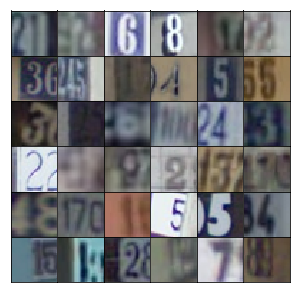

In [6]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [7]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [8]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), self.scaler(y)

## Network Inputs

Here, just creating some placeholders like normal.

In [9]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [10]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x = tf.layers.dense(z, 4*4*512)
        x = tf.reshape(x, (-1, 4, 4, 512))
        x = tf.layers.batch_normalization(x, training=training)
        # Leaky ReLU
        x = tf.maximum(alpha * x, x)
        # 4x4x512
        
        # Transposed convolutional layers
        # https://www.tensorflow.org/api_docs/python/tf/layers/conv2d_transpose
        # Conv 1
        x = tf.layers.conv2d_transpose(x, 256, (5,5), 2, 'same', activation=None)
        x = tf.layers.batch_normalization(x, training=training)
        #conv_layer = tf.nn.relu(conv_layer)
        x = tf.maximum(alpha * x, x)
        # 8x8x256
        
        # Conv 2
        x = tf.layers.conv2d_transpose(x, 128, (5,5), 2, 'same', activation=None)
        x = tf.layers.batch_normalization(x, training=training)
        #conv_layer = tf.nn.relu(conv_layer)
        x = tf.maximum(alpha * x, x)
        # 16x16x128
        
        # Conv 3
        #conv_layer = tf.layers.conv2d_transpose(conv_layer, 3, (5,5), 2, 'same', use_bias=False, activation=None)
        #conv_layer = tf.layers.batch_normalization(conv_layer, training=training)
        #conv_layer = tf.maximum(alpha * conv_layer, conv_layer)
       
        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(x, output_dim, (5,5), 2, 'same', activation=None)
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've build before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [11]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x = tf.layers.conv2d(x, 64, (5,5), 2, padding='same')
        x = tf.maximum(alpha * x, x)
        # 16x16x64
        
        x = tf.layers.conv2d(x, 128, (5,5), 2, padding='same')
        x = tf.layers.batch_normalization(x, training=True)
        x = tf.maximum(alpha * x, x)
        # 8x8x128
        
        x = tf.layers.conv2d(x, 256, (5,5), 2, padding='same')
        x = tf.layers.batch_normalization(x, training=True)
        x = tf.maximum(alpha * x, x)
        # 4x4x256
        
        flat = tf.reshape(x, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [12]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Again, nothing new here.

In [13]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
    g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [14]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=0.2)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, 0.5)

Here is a function for displaying generated images.

In [15]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img)
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network.

In [16]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(50, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 5, 10, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very senstive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [19]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 20
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/20... Discriminator Loss: 1.3080... Generator Loss: 0.8567
Epoch 1/20... Discriminator Loss: 0.4933... Generator Loss: 1.4792
Epoch 1/20... Discriminator Loss: 0.2481... Generator Loss: 1.9026
Epoch 1/20... Discriminator Loss: 0.1561... Generator Loss: 2.6487
Epoch 1/20... Discriminator Loss: 0.1539... Generator Loss: 2.8693
Epoch 1/20... Discriminator Loss: 0.0882... Generator Loss: 3.1498
Epoch 1/20... Discriminator Loss: 0.1094... Generator Loss: 2.9259
Epoch 1/20... Discriminator Loss: 0.1812... Generator Loss: 2.9647
Epoch 1/20... Discriminator Loss: 0.1528... Generator Loss: 2.9424
Epoch 1/20... Discriminator Loss: 0.1328... Generator Loss: 3.3837


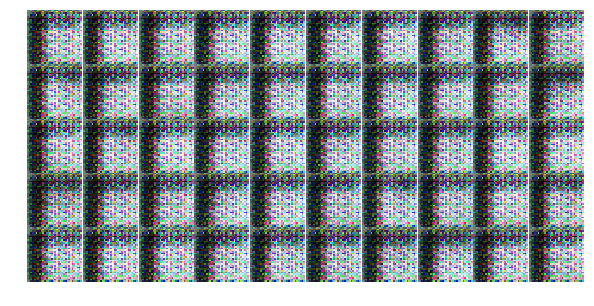

Epoch 1/20... Discriminator Loss: 0.1100... Generator Loss: 2.9184
Epoch 1/20... Discriminator Loss: 0.3216... Generator Loss: 2.3520
Epoch 1/20... Discriminator Loss: 0.8119... Generator Loss: 2.0655
Epoch 1/20... Discriminator Loss: 0.7628... Generator Loss: 1.1477
Epoch 1/20... Discriminator Loss: 0.6729... Generator Loss: 1.0363
Epoch 1/20... Discriminator Loss: 0.4597... Generator Loss: 1.8264
Epoch 1/20... Discriminator Loss: 0.5181... Generator Loss: 1.8733
Epoch 1/20... Discriminator Loss: 0.4278... Generator Loss: 2.5098
Epoch 1/20... Discriminator Loss: 0.8047... Generator Loss: 0.8832
Epoch 1/20... Discriminator Loss: 0.4569... Generator Loss: 3.1284


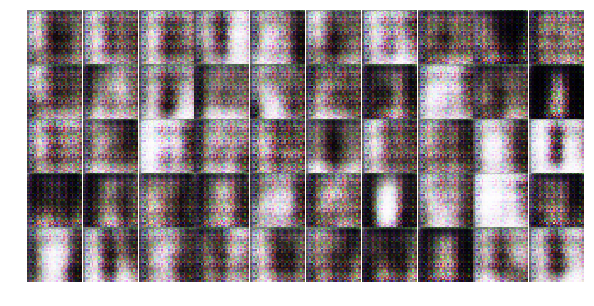

Epoch 1/20... Discriminator Loss: 0.6709... Generator Loss: 2.0639
Epoch 1/20... Discriminator Loss: 0.4420... Generator Loss: 3.5423
Epoch 1/20... Discriminator Loss: 0.4361... Generator Loss: 2.0494
Epoch 1/20... Discriminator Loss: 0.1495... Generator Loss: 2.9451
Epoch 1/20... Discriminator Loss: 0.8577... Generator Loss: 1.1094
Epoch 1/20... Discriminator Loss: 0.9814... Generator Loss: 1.4688
Epoch 1/20... Discriminator Loss: 0.9040... Generator Loss: 1.0132
Epoch 1/20... Discriminator Loss: 0.5156... Generator Loss: 2.3751
Epoch 1/20... Discriminator Loss: 0.2897... Generator Loss: 2.3386
Epoch 1/20... Discriminator Loss: 0.9482... Generator Loss: 1.3099


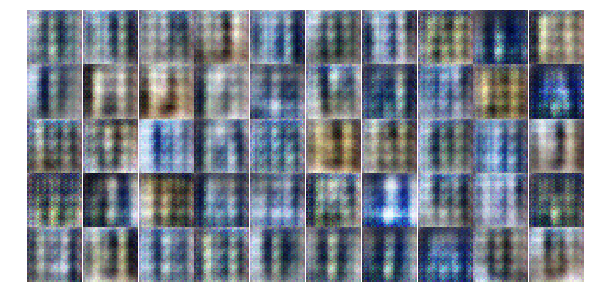

Epoch 1/20... Discriminator Loss: 1.4732... Generator Loss: 0.5085
Epoch 1/20... Discriminator Loss: 0.6564... Generator Loss: 1.5623
Epoch 1/20... Discriminator Loss: 0.5872... Generator Loss: 1.6902
Epoch 1/20... Discriminator Loss: 0.5268... Generator Loss: 1.4906
Epoch 1/20... Discriminator Loss: 0.5058... Generator Loss: 1.5569
Epoch 1/20... Discriminator Loss: 1.0544... Generator Loss: 1.3041
Epoch 1/20... Discriminator Loss: 0.5689... Generator Loss: 1.5648
Epoch 1/20... Discriminator Loss: 0.8170... Generator Loss: 1.3487
Epoch 1/20... Discriminator Loss: 0.7290... Generator Loss: 1.6477
Epoch 1/20... Discriminator Loss: 0.8298... Generator Loss: 1.2729


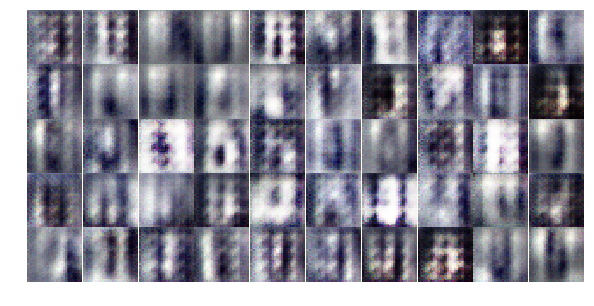

Epoch 1/20... Discriminator Loss: 0.6868... Generator Loss: 1.5768
Epoch 1/20... Discriminator Loss: 0.8888... Generator Loss: 1.1433
Epoch 1/20... Discriminator Loss: 0.5839... Generator Loss: 1.5357
Epoch 1/20... Discriminator Loss: 0.7278... Generator Loss: 1.6376
Epoch 1/20... Discriminator Loss: 0.6239... Generator Loss: 1.4952
Epoch 1/20... Discriminator Loss: 0.6587... Generator Loss: 1.6993
Epoch 1/20... Discriminator Loss: 0.9254... Generator Loss: 1.6263
Epoch 1/20... Discriminator Loss: 0.9852... Generator Loss: 0.9297
Epoch 1/20... Discriminator Loss: 0.7108... Generator Loss: 1.0550
Epoch 1/20... Discriminator Loss: 1.1027... Generator Loss: 1.4679


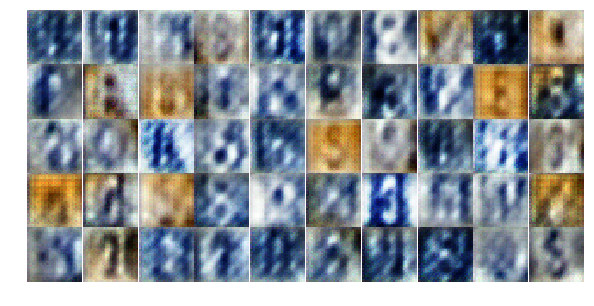

Epoch 1/20... Discriminator Loss: 0.8157... Generator Loss: 1.5756
Epoch 1/20... Discriminator Loss: 1.0506... Generator Loss: 0.8020
Epoch 1/20... Discriminator Loss: 0.4562... Generator Loss: 1.9767
Epoch 1/20... Discriminator Loss: 1.1166... Generator Loss: 0.6702
Epoch 1/20... Discriminator Loss: 0.7443... Generator Loss: 1.4994
Epoch 1/20... Discriminator Loss: 0.5260... Generator Loss: 1.4854
Epoch 1/20... Discriminator Loss: 1.0067... Generator Loss: 2.1879
Epoch 2/20... Discriminator Loss: 0.9393... Generator Loss: 1.5850
Epoch 2/20... Discriminator Loss: 0.9507... Generator Loss: 1.8583
Epoch 2/20... Discriminator Loss: 1.0463... Generator Loss: 1.1607


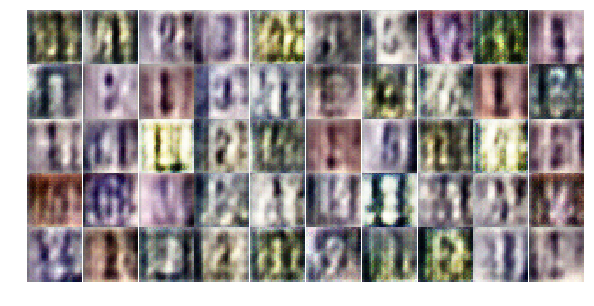

Epoch 2/20... Discriminator Loss: 0.9951... Generator Loss: 1.0668
Epoch 2/20... Discriminator Loss: 1.0959... Generator Loss: 1.6893
Epoch 2/20... Discriminator Loss: 1.5497... Generator Loss: 0.5677
Epoch 2/20... Discriminator Loss: 1.5183... Generator Loss: 0.9052
Epoch 2/20... Discriminator Loss: 1.3906... Generator Loss: 0.5269
Epoch 2/20... Discriminator Loss: 1.0198... Generator Loss: 0.9592
Epoch 2/20... Discriminator Loss: 1.2610... Generator Loss: 0.7740
Epoch 2/20... Discriminator Loss: 1.0173... Generator Loss: 0.9752
Epoch 2/20... Discriminator Loss: 0.9012... Generator Loss: 1.0156
Epoch 2/20... Discriminator Loss: 0.8914... Generator Loss: 1.5244


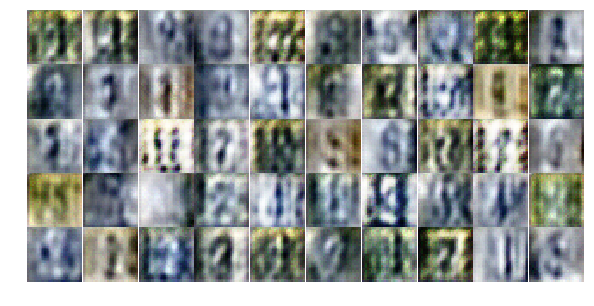

Epoch 2/20... Discriminator Loss: 0.9301... Generator Loss: 0.9437
Epoch 2/20... Discriminator Loss: 0.9291... Generator Loss: 1.2507
Epoch 2/20... Discriminator Loss: 0.5915... Generator Loss: 1.9904
Epoch 2/20... Discriminator Loss: 0.8185... Generator Loss: 1.3124
Epoch 2/20... Discriminator Loss: 0.7597... Generator Loss: 1.2381
Epoch 2/20... Discriminator Loss: 1.0956... Generator Loss: 0.9425
Epoch 2/20... Discriminator Loss: 1.2736... Generator Loss: 0.7380
Epoch 2/20... Discriminator Loss: 1.0290... Generator Loss: 0.9606
Epoch 2/20... Discriminator Loss: 0.9071... Generator Loss: 1.2877
Epoch 2/20... Discriminator Loss: 1.1729... Generator Loss: 0.6244


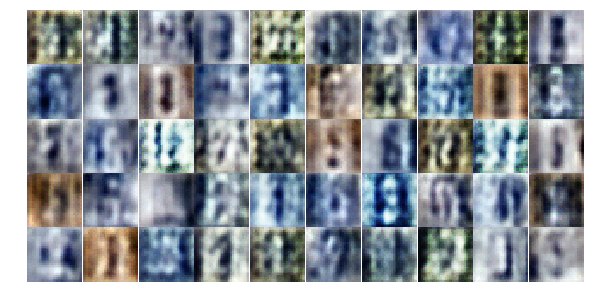

Epoch 2/20... Discriminator Loss: 1.2552... Generator Loss: 0.8299
Epoch 2/20... Discriminator Loss: 0.8958... Generator Loss: 0.9514
Epoch 2/20... Discriminator Loss: 0.7127... Generator Loss: 1.3890
Epoch 2/20... Discriminator Loss: 1.0725... Generator Loss: 1.6980
Epoch 2/20... Discriminator Loss: 0.9042... Generator Loss: 1.0413
Epoch 2/20... Discriminator Loss: 1.0242... Generator Loss: 0.9493
Epoch 2/20... Discriminator Loss: 1.0616... Generator Loss: 0.8929
Epoch 2/20... Discriminator Loss: 1.0754... Generator Loss: 0.8882
Epoch 2/20... Discriminator Loss: 1.0024... Generator Loss: 1.2872
Epoch 2/20... Discriminator Loss: 0.8566... Generator Loss: 0.9505


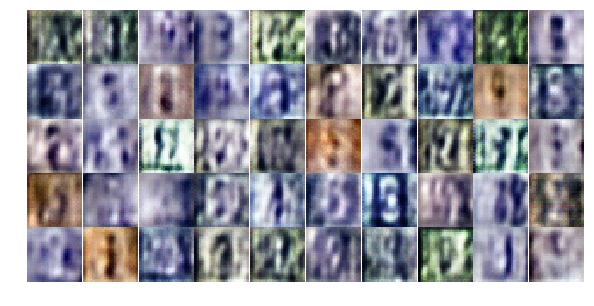

Epoch 2/20... Discriminator Loss: 1.3960... Generator Loss: 1.3578
Epoch 2/20... Discriminator Loss: 1.2674... Generator Loss: 0.8313
Epoch 2/20... Discriminator Loss: 1.5268... Generator Loss: 0.6502
Epoch 2/20... Discriminator Loss: 1.2517... Generator Loss: 0.7991
Epoch 2/20... Discriminator Loss: 0.9886... Generator Loss: 1.4108
Epoch 2/20... Discriminator Loss: 1.3363... Generator Loss: 1.4778
Epoch 2/20... Discriminator Loss: 1.0317... Generator Loss: 0.9748
Epoch 2/20... Discriminator Loss: 0.8965... Generator Loss: 1.9300
Epoch 2/20... Discriminator Loss: 1.0863... Generator Loss: 0.9449
Epoch 2/20... Discriminator Loss: 1.0662... Generator Loss: 1.3488


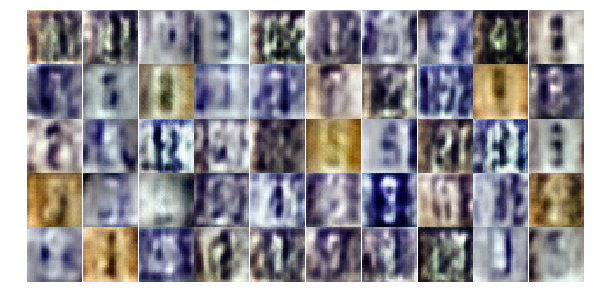

Epoch 2/20... Discriminator Loss: 0.9268... Generator Loss: 1.0634
Epoch 2/20... Discriminator Loss: 1.0520... Generator Loss: 1.2365
Epoch 2/20... Discriminator Loss: 1.6143... Generator Loss: 2.0928
Epoch 2/20... Discriminator Loss: 1.0920... Generator Loss: 0.8597
Epoch 2/20... Discriminator Loss: 1.1327... Generator Loss: 0.7830
Epoch 2/20... Discriminator Loss: 1.2058... Generator Loss: 0.7194
Epoch 2/20... Discriminator Loss: 1.1241... Generator Loss: 1.1632
Epoch 2/20... Discriminator Loss: 1.0936... Generator Loss: 0.8527
Epoch 2/20... Discriminator Loss: 0.7753... Generator Loss: 1.3536
Epoch 2/20... Discriminator Loss: 0.8159... Generator Loss: 1.2585


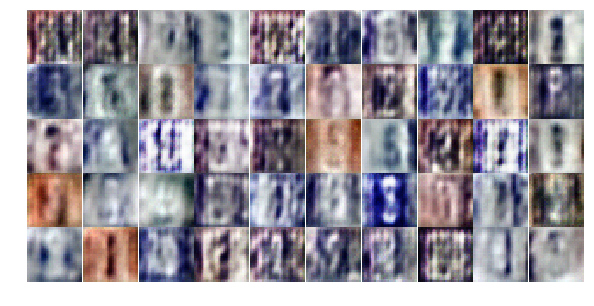

Epoch 2/20... Discriminator Loss: 0.6848... Generator Loss: 1.2888
Epoch 2/20... Discriminator Loss: 0.7122... Generator Loss: 1.7035
Epoch 2/20... Discriminator Loss: 1.1356... Generator Loss: 0.8059
Epoch 2/20... Discriminator Loss: 1.3942... Generator Loss: 0.5058
Epoch 3/20... Discriminator Loss: 0.9690... Generator Loss: 1.8436
Epoch 3/20... Discriminator Loss: 0.6128... Generator Loss: 1.5343
Epoch 3/20... Discriminator Loss: 0.8102... Generator Loss: 0.9320
Epoch 3/20... Discriminator Loss: 0.9533... Generator Loss: 0.8392
Epoch 3/20... Discriminator Loss: 0.7184... Generator Loss: 1.1333
Epoch 3/20... Discriminator Loss: 1.0963... Generator Loss: 0.9494


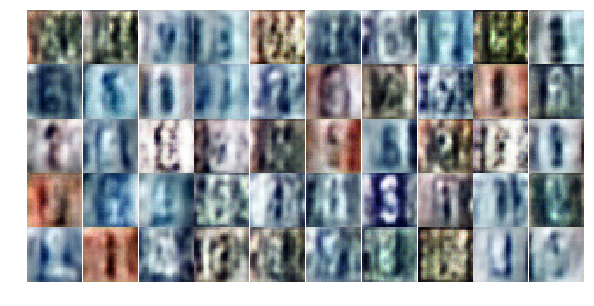

Epoch 3/20... Discriminator Loss: 0.5701... Generator Loss: 1.3404
Epoch 3/20... Discriminator Loss: 0.9060... Generator Loss: 0.8859
Epoch 3/20... Discriminator Loss: 0.7274... Generator Loss: 1.6409
Epoch 3/20... Discriminator Loss: 0.8812... Generator Loss: 1.0969
Epoch 3/20... Discriminator Loss: 1.3185... Generator Loss: 0.4227
Epoch 3/20... Discriminator Loss: 0.8985... Generator Loss: 0.9812
Epoch 3/20... Discriminator Loss: 0.7328... Generator Loss: 1.1945
Epoch 3/20... Discriminator Loss: 0.6676... Generator Loss: 1.2692
Epoch 3/20... Discriminator Loss: 0.6034... Generator Loss: 1.1069
Epoch 3/20... Discriminator Loss: 0.7424... Generator Loss: 1.1324


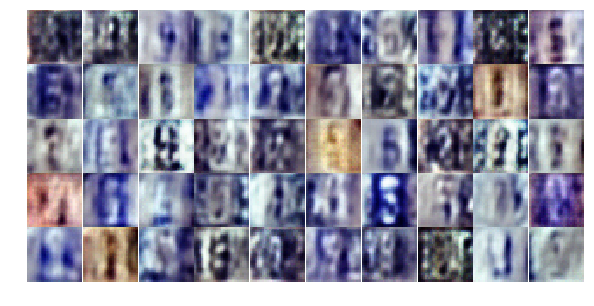

Epoch 3/20... Discriminator Loss: 0.6112... Generator Loss: 1.4139
Epoch 3/20... Discriminator Loss: 0.8503... Generator Loss: 1.3995
Epoch 3/20... Discriminator Loss: 0.4953... Generator Loss: 1.9279
Epoch 3/20... Discriminator Loss: 0.6610... Generator Loss: 1.8203
Epoch 3/20... Discriminator Loss: 1.2125... Generator Loss: 1.7262
Epoch 3/20... Discriminator Loss: 0.6862... Generator Loss: 1.1983
Epoch 3/20... Discriminator Loss: 0.8757... Generator Loss: 0.7796
Epoch 3/20... Discriminator Loss: 1.3368... Generator Loss: 2.1311
Epoch 3/20... Discriminator Loss: 0.9925... Generator Loss: 1.8188
Epoch 3/20... Discriminator Loss: 1.8475... Generator Loss: 0.2697


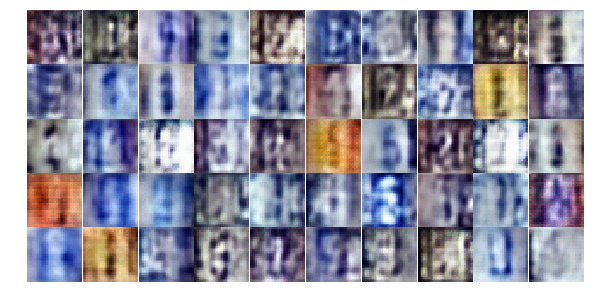

Epoch 3/20... Discriminator Loss: 0.5433... Generator Loss: 1.6713
Epoch 3/20... Discriminator Loss: 0.6003... Generator Loss: 2.1384
Epoch 3/20... Discriminator Loss: 1.1175... Generator Loss: 0.5051
Epoch 3/20... Discriminator Loss: 0.5396... Generator Loss: 1.6612
Epoch 3/20... Discriminator Loss: 0.9233... Generator Loss: 0.7332
Epoch 3/20... Discriminator Loss: 0.4448... Generator Loss: 1.9976
Epoch 3/20... Discriminator Loss: 0.9514... Generator Loss: 0.7372
Epoch 3/20... Discriminator Loss: 0.8438... Generator Loss: 0.9521
Epoch 3/20... Discriminator Loss: 1.0100... Generator Loss: 0.6368
Epoch 3/20... Discriminator Loss: 0.8135... Generator Loss: 0.8940


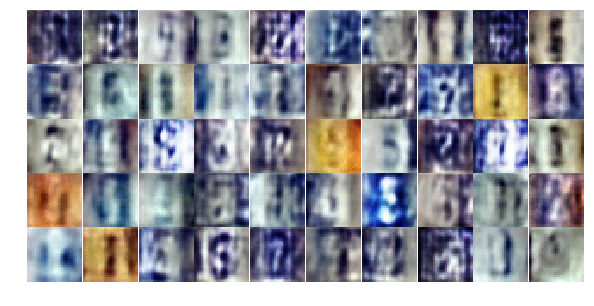

Epoch 3/20... Discriminator Loss: 0.9229... Generator Loss: 2.3268
Epoch 3/20... Discriminator Loss: 0.5327... Generator Loss: 1.4108
Epoch 3/20... Discriminator Loss: 0.5007... Generator Loss: 1.9591
Epoch 3/20... Discriminator Loss: 0.5533... Generator Loss: 1.4614
Epoch 3/20... Discriminator Loss: 0.4636... Generator Loss: 1.5731
Epoch 3/20... Discriminator Loss: 0.4380... Generator Loss: 1.4459
Epoch 3/20... Discriminator Loss: 0.5981... Generator Loss: 1.5737
Epoch 3/20... Discriminator Loss: 0.9040... Generator Loss: 0.7191
Epoch 3/20... Discriminator Loss: 0.7338... Generator Loss: 1.2012
Epoch 3/20... Discriminator Loss: 0.6947... Generator Loss: 1.4406


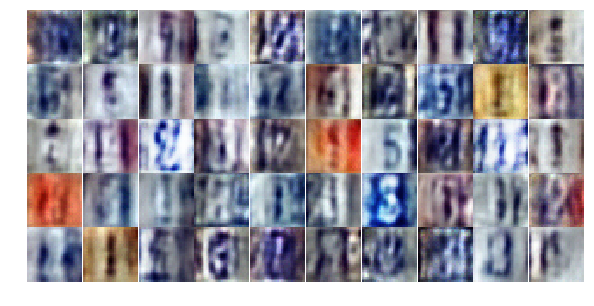

Epoch 3/20... Discriminator Loss: 0.6659... Generator Loss: 1.1389
Epoch 3/20... Discriminator Loss: 0.7728... Generator Loss: 1.9145
Epoch 3/20... Discriminator Loss: 0.5001... Generator Loss: 1.7022
Epoch 3/20... Discriminator Loss: 0.3679... Generator Loss: 2.1175
Epoch 3/20... Discriminator Loss: 0.9852... Generator Loss: 0.7688
Epoch 3/20... Discriminator Loss: 0.8858... Generator Loss: 1.4353
Epoch 3/20... Discriminator Loss: 0.6453... Generator Loss: 1.8218
Epoch 3/20... Discriminator Loss: 0.6841... Generator Loss: 2.1074
Epoch 3/20... Discriminator Loss: 0.5774... Generator Loss: 1.2563
Epoch 3/20... Discriminator Loss: 0.4217... Generator Loss: 2.1937


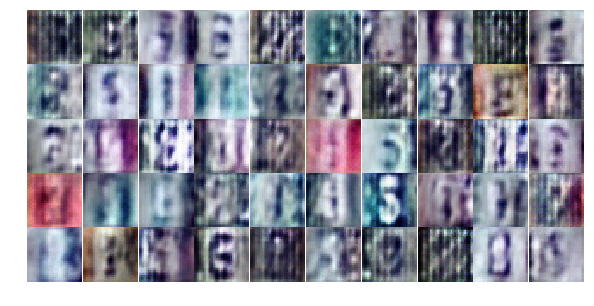

Epoch 3/20... Discriminator Loss: 0.9294... Generator Loss: 0.8340
Epoch 4/20... Discriminator Loss: 0.5877... Generator Loss: 1.2523
Epoch 4/20... Discriminator Loss: 0.4629... Generator Loss: 1.7431
Epoch 4/20... Discriminator Loss: 0.7991... Generator Loss: 0.8306
Epoch 4/20... Discriminator Loss: 0.4153... Generator Loss: 1.9759
Epoch 4/20... Discriminator Loss: 0.6066... Generator Loss: 1.5274
Epoch 4/20... Discriminator Loss: 0.8795... Generator Loss: 1.1957
Epoch 4/20... Discriminator Loss: 0.5165... Generator Loss: 1.7977
Epoch 4/20... Discriminator Loss: 0.6394... Generator Loss: 1.2297
Epoch 4/20... Discriminator Loss: 1.3022... Generator Loss: 0.4110


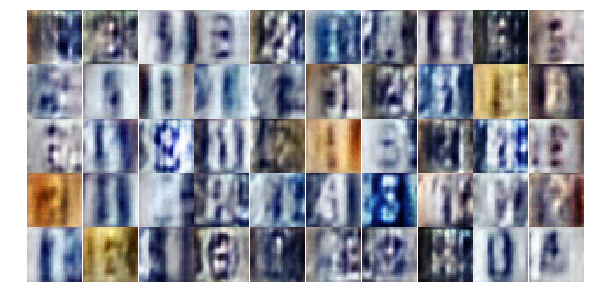

Epoch 4/20... Discriminator Loss: 0.5588... Generator Loss: 1.6361
Epoch 4/20... Discriminator Loss: 0.6911... Generator Loss: 1.2143
Epoch 4/20... Discriminator Loss: 0.9055... Generator Loss: 1.0023
Epoch 4/20... Discriminator Loss: 0.6036... Generator Loss: 1.9308
Epoch 4/20... Discriminator Loss: 0.7049... Generator Loss: 1.0331
Epoch 4/20... Discriminator Loss: 1.6675... Generator Loss: 0.3398
Epoch 4/20... Discriminator Loss: 1.1420... Generator Loss: 0.5899
Epoch 4/20... Discriminator Loss: 0.6165... Generator Loss: 1.2256
Epoch 4/20... Discriminator Loss: 0.7549... Generator Loss: 1.8108
Epoch 4/20... Discriminator Loss: 0.4197... Generator Loss: 1.6155


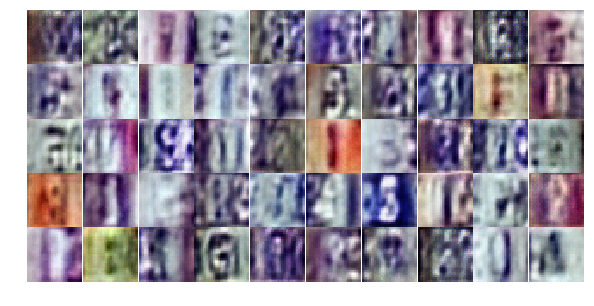

Epoch 4/20... Discriminator Loss: 0.7664... Generator Loss: 0.9275
Epoch 4/20... Discriminator Loss: 0.3618... Generator Loss: 1.9290
Epoch 4/20... Discriminator Loss: 1.3190... Generator Loss: 0.4470
Epoch 4/20... Discriminator Loss: 1.3971... Generator Loss: 0.4675
Epoch 4/20... Discriminator Loss: 0.4898... Generator Loss: 1.6088
Epoch 4/20... Discriminator Loss: 0.5048... Generator Loss: 1.5286
Epoch 4/20... Discriminator Loss: 0.7267... Generator Loss: 1.0249
Epoch 4/20... Discriminator Loss: 0.7836... Generator Loss: 1.4682
Epoch 4/20... Discriminator Loss: 0.5522... Generator Loss: 1.5240
Epoch 4/20... Discriminator Loss: 0.3655... Generator Loss: 1.7027


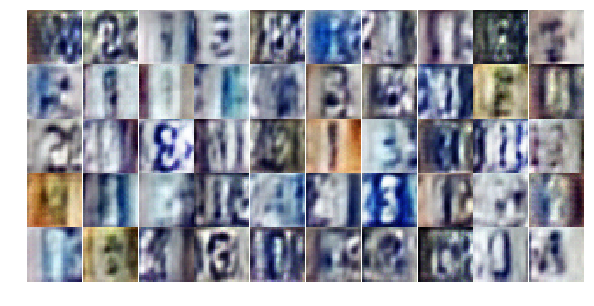

Epoch 4/20... Discriminator Loss: 0.4505... Generator Loss: 1.9102
Epoch 4/20... Discriminator Loss: 0.6851... Generator Loss: 1.3043
Epoch 4/20... Discriminator Loss: 0.4865... Generator Loss: 1.5658
Epoch 4/20... Discriminator Loss: 0.4609... Generator Loss: 1.6580
Epoch 4/20... Discriminator Loss: 0.4172... Generator Loss: 1.6959
Epoch 4/20... Discriminator Loss: 0.7949... Generator Loss: 1.1105
Epoch 4/20... Discriminator Loss: 0.8691... Generator Loss: 0.8068
Epoch 4/20... Discriminator Loss: 0.4805... Generator Loss: 1.4478
Epoch 4/20... Discriminator Loss: 0.4092... Generator Loss: 1.4583
Epoch 4/20... Discriminator Loss: 0.5390... Generator Loss: 1.6780


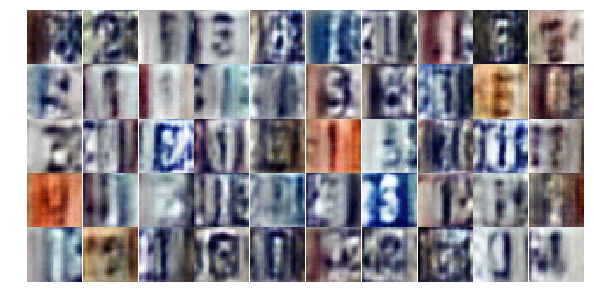

Epoch 4/20... Discriminator Loss: 0.5132... Generator Loss: 1.3583
Epoch 4/20... Discriminator Loss: 0.6145... Generator Loss: 1.8574
Epoch 4/20... Discriminator Loss: 1.7676... Generator Loss: 0.2838
Epoch 4/20... Discriminator Loss: 0.6682... Generator Loss: 1.9448
Epoch 4/20... Discriminator Loss: 0.3500... Generator Loss: 1.9643
Epoch 4/20... Discriminator Loss: 0.5972... Generator Loss: 2.1104
Epoch 4/20... Discriminator Loss: 0.5683... Generator Loss: 1.2506
Epoch 4/20... Discriminator Loss: 0.6443... Generator Loss: 2.1843
Epoch 4/20... Discriminator Loss: 0.6706... Generator Loss: 1.1136
Epoch 4/20... Discriminator Loss: 0.7130... Generator Loss: 1.5202


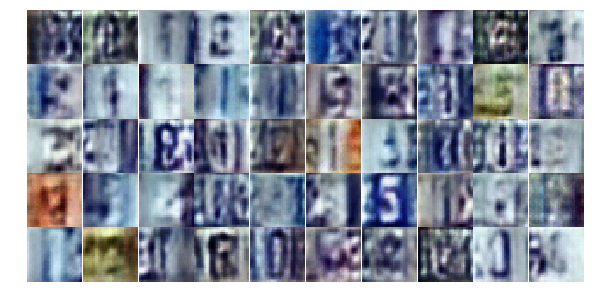

Epoch 4/20... Discriminator Loss: 0.5482... Generator Loss: 1.3796
Epoch 4/20... Discriminator Loss: 0.6864... Generator Loss: 2.7384
Epoch 4/20... Discriminator Loss: 0.3907... Generator Loss: 1.8278
Epoch 4/20... Discriminator Loss: 0.4234... Generator Loss: 2.4399
Epoch 4/20... Discriminator Loss: 0.3663... Generator Loss: 1.8421
Epoch 4/20... Discriminator Loss: 0.4635... Generator Loss: 2.0415
Epoch 4/20... Discriminator Loss: 0.3607... Generator Loss: 1.6722
Epoch 4/20... Discriminator Loss: 0.7590... Generator Loss: 0.9835
Epoch 4/20... Discriminator Loss: 0.8478... Generator Loss: 2.1227
Epoch 5/20... Discriminator Loss: 0.7591... Generator Loss: 1.0557


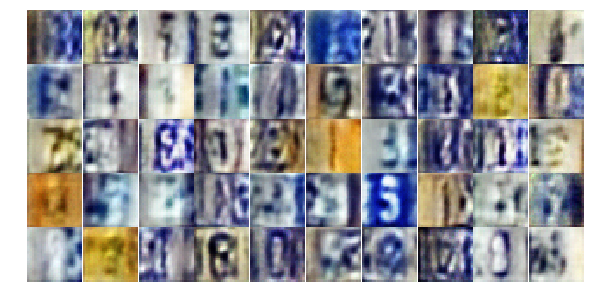

Epoch 5/20... Discriminator Loss: 0.6075... Generator Loss: 1.3098
Epoch 5/20... Discriminator Loss: 1.4871... Generator Loss: 0.3327
Epoch 5/20... Discriminator Loss: 0.9732... Generator Loss: 2.6899
Epoch 5/20... Discriminator Loss: 0.5154... Generator Loss: 1.2647
Epoch 5/20... Discriminator Loss: 0.4083... Generator Loss: 1.8549
Epoch 5/20... Discriminator Loss: 0.8106... Generator Loss: 0.8780
Epoch 5/20... Discriminator Loss: 0.5043... Generator Loss: 1.2460
Epoch 5/20... Discriminator Loss: 0.5523... Generator Loss: 2.3994
Epoch 5/20... Discriminator Loss: 0.7622... Generator Loss: 0.8796
Epoch 5/20... Discriminator Loss: 0.9359... Generator Loss: 0.8257


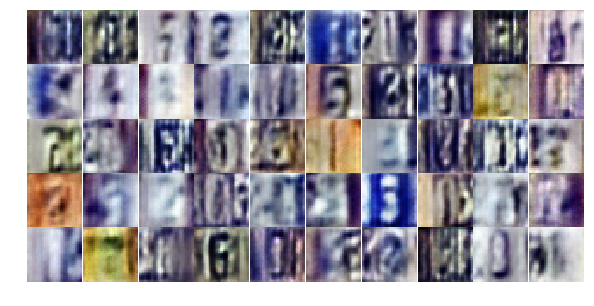

Epoch 5/20... Discriminator Loss: 0.6939... Generator Loss: 1.3426
Epoch 5/20... Discriminator Loss: 0.5186... Generator Loss: 2.4587
Epoch 5/20... Discriminator Loss: 0.7034... Generator Loss: 0.9386
Epoch 5/20... Discriminator Loss: 1.7867... Generator Loss: 0.2555
Epoch 5/20... Discriminator Loss: 0.7396... Generator Loss: 2.0540
Epoch 5/20... Discriminator Loss: 0.7371... Generator Loss: 0.9482
Epoch 5/20... Discriminator Loss: 0.5006... Generator Loss: 1.8360
Epoch 5/20... Discriminator Loss: 0.5489... Generator Loss: 1.8032
Epoch 5/20... Discriminator Loss: 0.7325... Generator Loss: 1.3036
Epoch 5/20... Discriminator Loss: 0.5310... Generator Loss: 1.5378


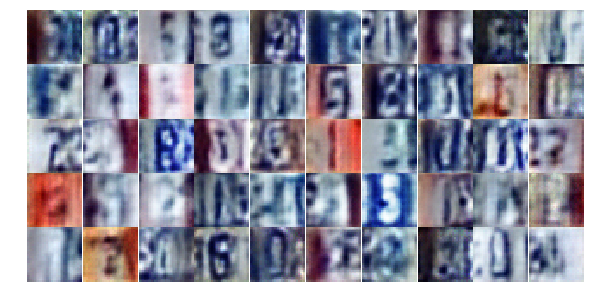

Epoch 5/20... Discriminator Loss: 0.5167... Generator Loss: 1.3685
Epoch 5/20... Discriminator Loss: 0.6990... Generator Loss: 1.5481
Epoch 5/20... Discriminator Loss: 0.4775... Generator Loss: 1.3968
Epoch 5/20... Discriminator Loss: 0.8136... Generator Loss: 0.7919
Epoch 5/20... Discriminator Loss: 0.6742... Generator Loss: 0.8953
Epoch 5/20... Discriminator Loss: 1.1382... Generator Loss: 0.5426
Epoch 5/20... Discriminator Loss: 0.6358... Generator Loss: 1.0070
Epoch 5/20... Discriminator Loss: 1.3662... Generator Loss: 0.4847
Epoch 5/20... Discriminator Loss: 1.5503... Generator Loss: 0.3761
Epoch 5/20... Discriminator Loss: 0.5815... Generator Loss: 1.3030


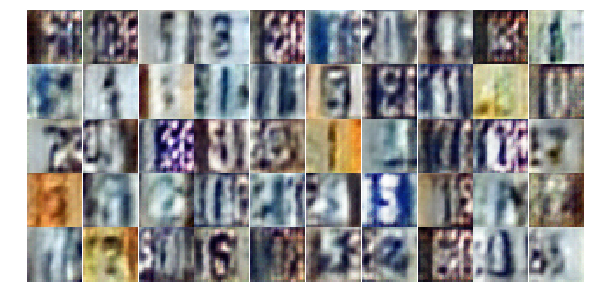

Epoch 5/20... Discriminator Loss: 0.7102... Generator Loss: 1.1906
Epoch 5/20... Discriminator Loss: 0.4778... Generator Loss: 1.8375
Epoch 5/20... Discriminator Loss: 0.6263... Generator Loss: 1.1476
Epoch 5/20... Discriminator Loss: 0.6046... Generator Loss: 1.1989
Epoch 5/20... Discriminator Loss: 0.7833... Generator Loss: 0.9735
Epoch 5/20... Discriminator Loss: 0.6612... Generator Loss: 1.3430
Epoch 5/20... Discriminator Loss: 0.7873... Generator Loss: 0.8815
Epoch 5/20... Discriminator Loss: 0.9255... Generator Loss: 0.7296
Epoch 5/20... Discriminator Loss: 0.7451... Generator Loss: 0.9527
Epoch 5/20... Discriminator Loss: 0.4295... Generator Loss: 1.5311


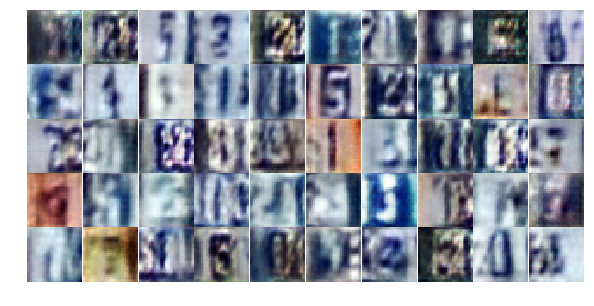

Epoch 5/20... Discriminator Loss: 0.3919... Generator Loss: 1.8628
Epoch 5/20... Discriminator Loss: 0.5733... Generator Loss: 1.1832
Epoch 5/20... Discriminator Loss: 1.4711... Generator Loss: 0.3524
Epoch 5/20... Discriminator Loss: 0.6127... Generator Loss: 1.2763
Epoch 5/20... Discriminator Loss: 1.0856... Generator Loss: 2.2920
Epoch 5/20... Discriminator Loss: 0.9966... Generator Loss: 0.6885
Epoch 5/20... Discriminator Loss: 0.8658... Generator Loss: 0.8032
Epoch 5/20... Discriminator Loss: 0.5833... Generator Loss: 1.2341
Epoch 5/20... Discriminator Loss: 0.6688... Generator Loss: 1.2425
Epoch 5/20... Discriminator Loss: 0.6407... Generator Loss: 1.1081


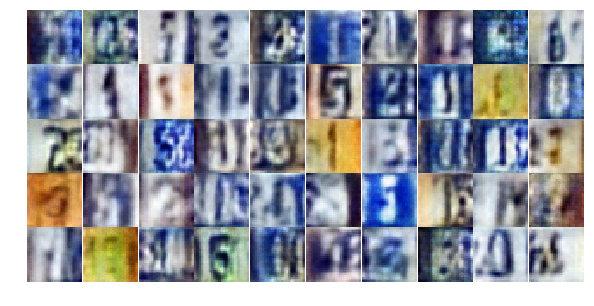

Epoch 5/20... Discriminator Loss: 0.7329... Generator Loss: 1.7972
Epoch 5/20... Discriminator Loss: 0.5229... Generator Loss: 1.4655
Epoch 5/20... Discriminator Loss: 0.6318... Generator Loss: 1.1429
Epoch 5/20... Discriminator Loss: 0.6138... Generator Loss: 1.2146
Epoch 5/20... Discriminator Loss: 0.6661... Generator Loss: 1.0257
Epoch 5/20... Discriminator Loss: 1.0830... Generator Loss: 1.8382
Epoch 6/20... Discriminator Loss: 0.9560... Generator Loss: 0.7066
Epoch 6/20... Discriminator Loss: 0.5096... Generator Loss: 1.4841
Epoch 6/20... Discriminator Loss: 0.4642... Generator Loss: 1.6450
Epoch 6/20... Discriminator Loss: 0.8228... Generator Loss: 0.8267


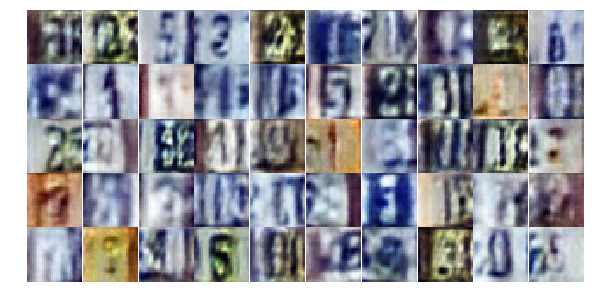

Epoch 6/20... Discriminator Loss: 0.8573... Generator Loss: 0.7732
Epoch 6/20... Discriminator Loss: 0.9646... Generator Loss: 0.7026
Epoch 6/20... Discriminator Loss: 0.6322... Generator Loss: 1.8314
Epoch 6/20... Discriminator Loss: 0.8155... Generator Loss: 0.8165
Epoch 6/20... Discriminator Loss: 0.9280... Generator Loss: 0.6644
Epoch 6/20... Discriminator Loss: 0.6456... Generator Loss: 1.0332
Epoch 6/20... Discriminator Loss: 0.9709... Generator Loss: 0.8659
Epoch 6/20... Discriminator Loss: 0.8753... Generator Loss: 1.0170
Epoch 6/20... Discriminator Loss: 0.7688... Generator Loss: 2.0280
Epoch 6/20... Discriminator Loss: 0.5872... Generator Loss: 1.3023


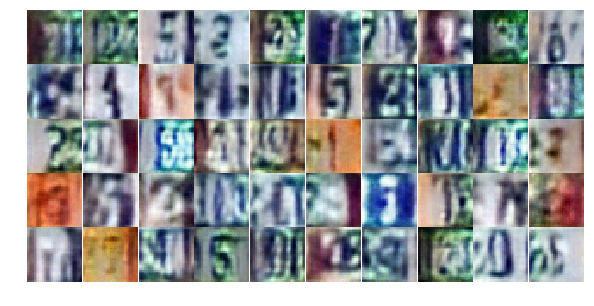

Epoch 6/20... Discriminator Loss: 0.5747... Generator Loss: 1.1973
Epoch 6/20... Discriminator Loss: 0.5848... Generator Loss: 1.4232
Epoch 6/20... Discriminator Loss: 0.5549... Generator Loss: 1.1885
Epoch 6/20... Discriminator Loss: 2.0715... Generator Loss: 0.2385
Epoch 6/20... Discriminator Loss: 0.5374... Generator Loss: 1.7237
Epoch 6/20... Discriminator Loss: 0.6701... Generator Loss: 1.9491
Epoch 6/20... Discriminator Loss: 0.5980... Generator Loss: 1.5679
Epoch 6/20... Discriminator Loss: 0.7934... Generator Loss: 0.8247
Epoch 6/20... Discriminator Loss: 0.6360... Generator Loss: 2.2913
Epoch 6/20... Discriminator Loss: 0.8411... Generator Loss: 0.7944


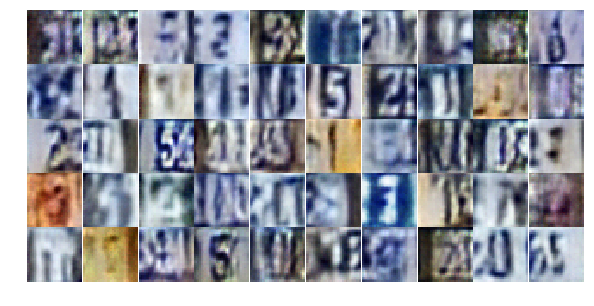

Epoch 6/20... Discriminator Loss: 0.8781... Generator Loss: 0.6983
Epoch 6/20... Discriminator Loss: 0.5872... Generator Loss: 1.5175
Epoch 6/20... Discriminator Loss: 0.7795... Generator Loss: 0.9398
Epoch 6/20... Discriminator Loss: 0.7797... Generator Loss: 0.7824
Epoch 6/20... Discriminator Loss: 0.6016... Generator Loss: 2.2490
Epoch 6/20... Discriminator Loss: 1.0098... Generator Loss: 0.7974
Epoch 6/20... Discriminator Loss: 0.7137... Generator Loss: 1.0290
Epoch 6/20... Discriminator Loss: 0.3478... Generator Loss: 1.5162
Epoch 6/20... Discriminator Loss: 0.5595... Generator Loss: 1.2722
Epoch 6/20... Discriminator Loss: 0.4761... Generator Loss: 1.6339


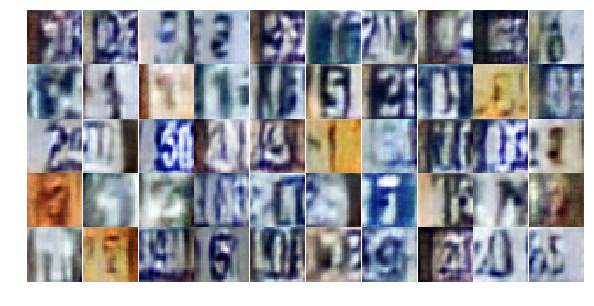

Epoch 6/20... Discriminator Loss: 1.3692... Generator Loss: 0.4283
Epoch 6/20... Discriminator Loss: 0.6887... Generator Loss: 1.2747
Epoch 6/20... Discriminator Loss: 1.2340... Generator Loss: 0.4882
Epoch 6/20... Discriminator Loss: 0.7125... Generator Loss: 1.2792
Epoch 6/20... Discriminator Loss: 0.6375... Generator Loss: 1.1290
Epoch 6/20... Discriminator Loss: 0.7563... Generator Loss: 0.9221
Epoch 6/20... Discriminator Loss: 0.5594... Generator Loss: 1.3634
Epoch 6/20... Discriminator Loss: 0.4736... Generator Loss: 1.6111
Epoch 6/20... Discriminator Loss: 0.7991... Generator Loss: 0.8593
Epoch 6/20... Discriminator Loss: 0.7421... Generator Loss: 0.8439


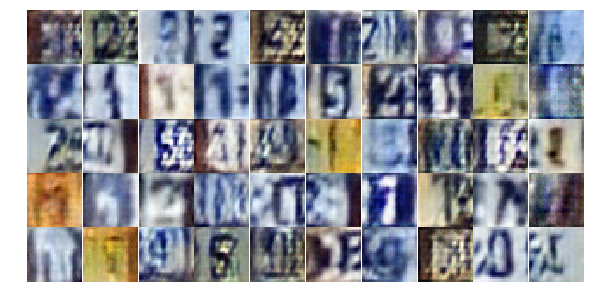

Epoch 6/20... Discriminator Loss: 0.7678... Generator Loss: 1.1682
Epoch 6/20... Discriminator Loss: 0.6162... Generator Loss: 1.6603
Epoch 6/20... Discriminator Loss: 0.7410... Generator Loss: 0.9228
Epoch 6/20... Discriminator Loss: 0.4434... Generator Loss: 1.9792
Epoch 6/20... Discriminator Loss: 0.4101... Generator Loss: 1.8691
Epoch 6/20... Discriminator Loss: 0.4325... Generator Loss: 2.1983
Epoch 6/20... Discriminator Loss: 0.6126... Generator Loss: 1.1145
Epoch 6/20... Discriminator Loss: 1.1692... Generator Loss: 0.5254
Epoch 6/20... Discriminator Loss: 0.9517... Generator Loss: 0.6979
Epoch 6/20... Discriminator Loss: 1.7249... Generator Loss: 0.2432


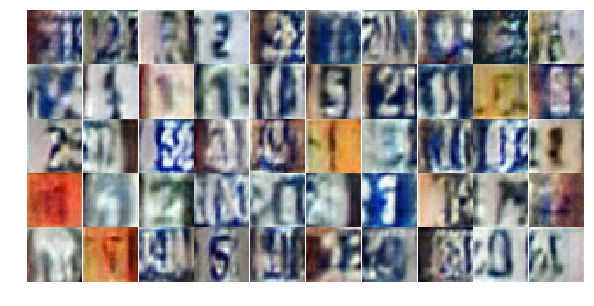

Epoch 6/20... Discriminator Loss: 0.6700... Generator Loss: 1.5037
Epoch 6/20... Discriminator Loss: 0.6422... Generator Loss: 1.1731
Epoch 6/20... Discriminator Loss: 0.7211... Generator Loss: 1.1682
Epoch 7/20... Discriminator Loss: 0.5624... Generator Loss: 1.5035
Epoch 7/20... Discriminator Loss: 0.6979... Generator Loss: 1.1664
Epoch 7/20... Discriminator Loss: 0.5663... Generator Loss: 1.3666
Epoch 7/20... Discriminator Loss: 0.3661... Generator Loss: 1.7871
Epoch 7/20... Discriminator Loss: 0.4751... Generator Loss: 1.5707
Epoch 7/20... Discriminator Loss: 0.6339... Generator Loss: 2.5766
Epoch 7/20... Discriminator Loss: 1.2068... Generator Loss: 0.5295


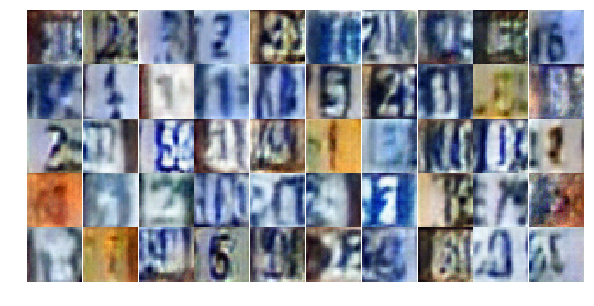

Epoch 7/20... Discriminator Loss: 0.5870... Generator Loss: 1.2246
Epoch 7/20... Discriminator Loss: 0.8219... Generator Loss: 0.8306
Epoch 7/20... Discriminator Loss: 0.6960... Generator Loss: 0.9286
Epoch 7/20... Discriminator Loss: 0.6104... Generator Loss: 1.7688
Epoch 7/20... Discriminator Loss: 0.4829... Generator Loss: 1.5216
Epoch 7/20... Discriminator Loss: 0.5554... Generator Loss: 1.3118
Epoch 7/20... Discriminator Loss: 0.8575... Generator Loss: 1.6925
Epoch 7/20... Discriminator Loss: 0.7692... Generator Loss: 2.4130
Epoch 7/20... Discriminator Loss: 1.7092... Generator Loss: 3.0969
Epoch 7/20... Discriminator Loss: 0.6944... Generator Loss: 1.0105


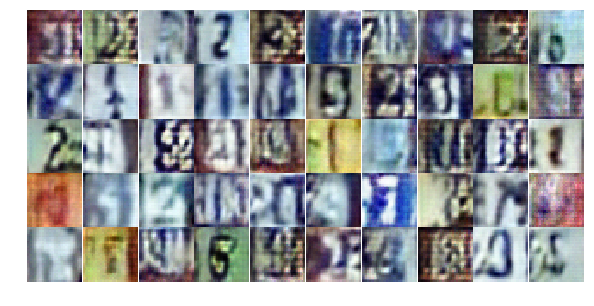

Epoch 7/20... Discriminator Loss: 0.5517... Generator Loss: 1.4450
Epoch 7/20... Discriminator Loss: 0.5058... Generator Loss: 1.5337
Epoch 7/20... Discriminator Loss: 0.9134... Generator Loss: 2.0943
Epoch 7/20... Discriminator Loss: 0.6071... Generator Loss: 1.5347
Epoch 7/20... Discriminator Loss: 0.4747... Generator Loss: 1.4766
Epoch 7/20... Discriminator Loss: 0.7432... Generator Loss: 0.9191
Epoch 7/20... Discriminator Loss: 0.8732... Generator Loss: 0.7324
Epoch 7/20... Discriminator Loss: 1.1643... Generator Loss: 0.5426
Epoch 7/20... Discriminator Loss: 0.2855... Generator Loss: 2.3253
Epoch 7/20... Discriminator Loss: 0.4230... Generator Loss: 1.9129


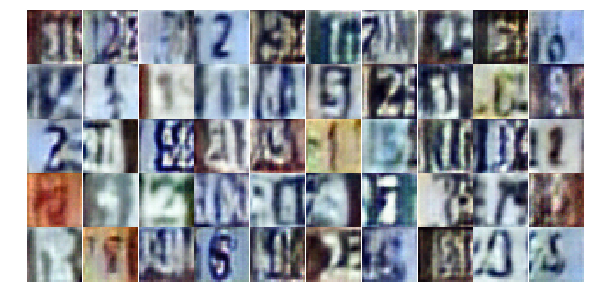

Epoch 7/20... Discriminator Loss: 0.7077... Generator Loss: 0.9199
Epoch 7/20... Discriminator Loss: 1.2794... Generator Loss: 0.4699
Epoch 7/20... Discriminator Loss: 0.4957... Generator Loss: 1.7228
Epoch 7/20... Discriminator Loss: 0.6764... Generator Loss: 1.0295
Epoch 7/20... Discriminator Loss: 0.7477... Generator Loss: 1.0225
Epoch 7/20... Discriminator Loss: 0.8304... Generator Loss: 0.9191
Epoch 7/20... Discriminator Loss: 0.3600... Generator Loss: 1.7198
Epoch 7/20... Discriminator Loss: 0.9180... Generator Loss: 0.7580
Epoch 7/20... Discriminator Loss: 1.1384... Generator Loss: 0.5338
Epoch 7/20... Discriminator Loss: 0.5039... Generator Loss: 2.2638


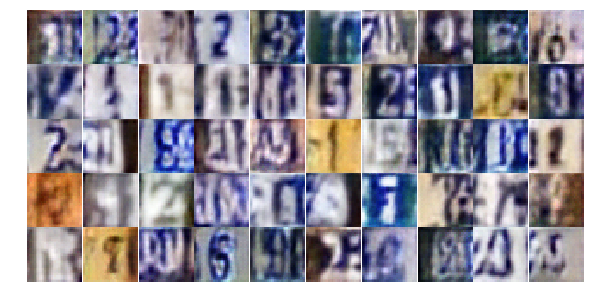

Epoch 7/20... Discriminator Loss: 1.2042... Generator Loss: 0.4748
Epoch 7/20... Discriminator Loss: 0.7079... Generator Loss: 1.0703
Epoch 7/20... Discriminator Loss: 0.5570... Generator Loss: 2.4141
Epoch 7/20... Discriminator Loss: 0.6421... Generator Loss: 1.3068
Epoch 7/20... Discriminator Loss: 0.6761... Generator Loss: 0.9979
Epoch 7/20... Discriminator Loss: 0.3912... Generator Loss: 2.4503
Epoch 7/20... Discriminator Loss: 0.5227... Generator Loss: 1.6884
Epoch 7/20... Discriminator Loss: 0.8666... Generator Loss: 1.7233
Epoch 7/20... Discriminator Loss: 0.5945... Generator Loss: 1.5551
Epoch 7/20... Discriminator Loss: 0.7846... Generator Loss: 1.1507


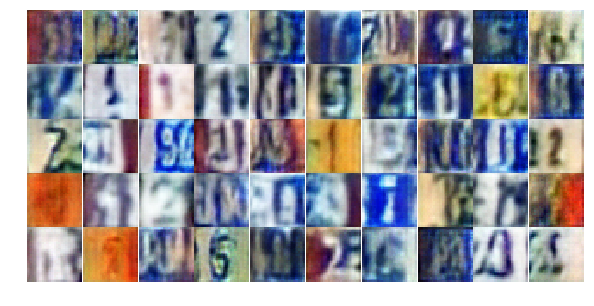

Epoch 7/20... Discriminator Loss: 0.5433... Generator Loss: 2.2950
Epoch 7/20... Discriminator Loss: 0.8433... Generator Loss: 0.9507
Epoch 7/20... Discriminator Loss: 0.7044... Generator Loss: 1.1413
Epoch 7/20... Discriminator Loss: 0.5579... Generator Loss: 1.1657
Epoch 7/20... Discriminator Loss: 0.6149... Generator Loss: 1.2583
Epoch 7/20... Discriminator Loss: 0.3772... Generator Loss: 1.9424
Epoch 7/20... Discriminator Loss: 1.5983... Generator Loss: 0.3255
Epoch 7/20... Discriminator Loss: 1.2209... Generator Loss: 0.5095
Epoch 7/20... Discriminator Loss: 0.6331... Generator Loss: 1.2296
Epoch 7/20... Discriminator Loss: 0.5719... Generator Loss: 1.1183


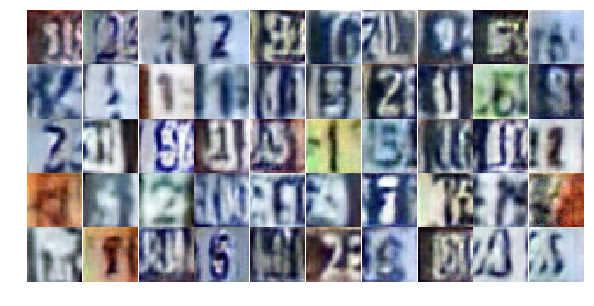

Epoch 7/20... Discriminator Loss: 0.4976... Generator Loss: 1.7367
Epoch 8/20... Discriminator Loss: 0.6469... Generator Loss: 1.1604
Epoch 8/20... Discriminator Loss: 1.0295... Generator Loss: 0.5551
Epoch 8/20... Discriminator Loss: 0.5550... Generator Loss: 1.3863
Epoch 8/20... Discriminator Loss: 0.4588... Generator Loss: 1.6203
Epoch 8/20... Discriminator Loss: 0.8879... Generator Loss: 0.8889
Epoch 8/20... Discriminator Loss: 1.2211... Generator Loss: 0.4786
Epoch 8/20... Discriminator Loss: 0.8207... Generator Loss: 3.3598
Epoch 8/20... Discriminator Loss: 1.2482... Generator Loss: 0.5659
Epoch 8/20... Discriminator Loss: 0.6618... Generator Loss: 1.2305


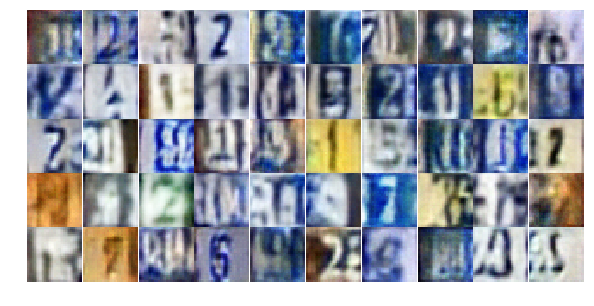

Epoch 8/20... Discriminator Loss: 0.4327... Generator Loss: 1.9239
Epoch 8/20... Discriminator Loss: 0.5140... Generator Loss: 1.7040
Epoch 8/20... Discriminator Loss: 0.6428... Generator Loss: 1.1056
Epoch 8/20... Discriminator Loss: 0.4396... Generator Loss: 1.7895
Epoch 8/20... Discriminator Loss: 1.7345... Generator Loss: 0.3247
Epoch 8/20... Discriminator Loss: 0.4971... Generator Loss: 1.6511
Epoch 8/20... Discriminator Loss: 0.4522... Generator Loss: 1.6444
Epoch 8/20... Discriminator Loss: 0.6246... Generator Loss: 1.4405
Epoch 8/20... Discriminator Loss: 0.8286... Generator Loss: 0.7633
Epoch 8/20... Discriminator Loss: 1.2320... Generator Loss: 0.5462


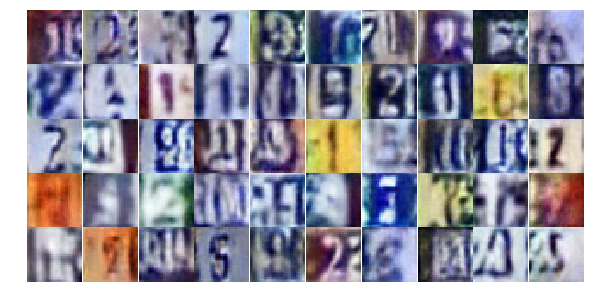

Epoch 8/20... Discriminator Loss: 0.4412... Generator Loss: 1.5513
Epoch 8/20... Discriminator Loss: 0.5486... Generator Loss: 1.1724
Epoch 8/20... Discriminator Loss: 0.6275... Generator Loss: 1.3732
Epoch 8/20... Discriminator Loss: 0.7005... Generator Loss: 2.3576
Epoch 8/20... Discriminator Loss: 0.4783... Generator Loss: 1.8765
Epoch 8/20... Discriminator Loss: 0.5452... Generator Loss: 1.3958
Epoch 8/20... Discriminator Loss: 0.6468... Generator Loss: 1.4946
Epoch 8/20... Discriminator Loss: 0.5085... Generator Loss: 1.2354
Epoch 8/20... Discriminator Loss: 0.8464... Generator Loss: 2.3070
Epoch 8/20... Discriminator Loss: 0.8576... Generator Loss: 0.7788


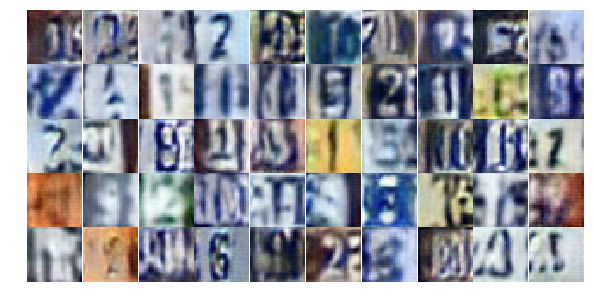

Epoch 8/20... Discriminator Loss: 0.9922... Generator Loss: 2.3317
Epoch 8/20... Discriminator Loss: 1.0637... Generator Loss: 0.5665
Epoch 8/20... Discriminator Loss: 0.5690... Generator Loss: 1.1757
Epoch 8/20... Discriminator Loss: 0.6171... Generator Loss: 1.0706
Epoch 8/20... Discriminator Loss: 0.4189... Generator Loss: 1.4567
Epoch 8/20... Discriminator Loss: 0.4817... Generator Loss: 1.3346
Epoch 8/20... Discriminator Loss: 0.7171... Generator Loss: 0.9253
Epoch 8/20... Discriminator Loss: 0.9077... Generator Loss: 0.6814
Epoch 8/20... Discriminator Loss: 0.9351... Generator Loss: 0.6910
Epoch 8/20... Discriminator Loss: 0.5571... Generator Loss: 1.2956


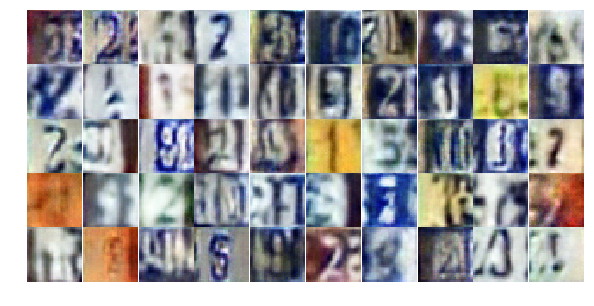

Epoch 8/20... Discriminator Loss: 0.6600... Generator Loss: 2.0099
Epoch 8/20... Discriminator Loss: 1.1749... Generator Loss: 0.6788
Epoch 8/20... Discriminator Loss: 1.1500... Generator Loss: 0.4948
Epoch 8/20... Discriminator Loss: 0.6062... Generator Loss: 2.3150
Epoch 8/20... Discriminator Loss: 1.3660... Generator Loss: 3.0481
Epoch 8/20... Discriminator Loss: 1.1009... Generator Loss: 0.6182
Epoch 8/20... Discriminator Loss: 0.4638... Generator Loss: 1.5572
Epoch 8/20... Discriminator Loss: 0.5094... Generator Loss: 1.3985
Epoch 8/20... Discriminator Loss: 0.6842... Generator Loss: 2.9590
Epoch 8/20... Discriminator Loss: 0.6224... Generator Loss: 1.1734


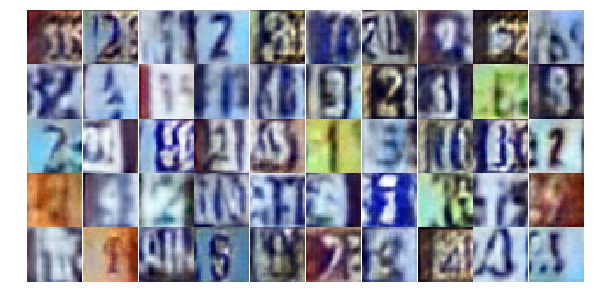

Epoch 8/20... Discriminator Loss: 0.4692... Generator Loss: 1.9193
Epoch 8/20... Discriminator Loss: 0.5851... Generator Loss: 1.0981
Epoch 8/20... Discriminator Loss: 0.6452... Generator Loss: 2.1796
Epoch 8/20... Discriminator Loss: 1.2427... Generator Loss: 0.4962
Epoch 8/20... Discriminator Loss: 0.4584... Generator Loss: 1.6149
Epoch 8/20... Discriminator Loss: 0.9682... Generator Loss: 0.6909
Epoch 8/20... Discriminator Loss: 0.6583... Generator Loss: 1.0265
Epoch 8/20... Discriminator Loss: 0.6479... Generator Loss: 1.9040
Epoch 9/20... Discriminator Loss: 0.8366... Generator Loss: 0.9628
Epoch 9/20... Discriminator Loss: 0.7486... Generator Loss: 0.8958


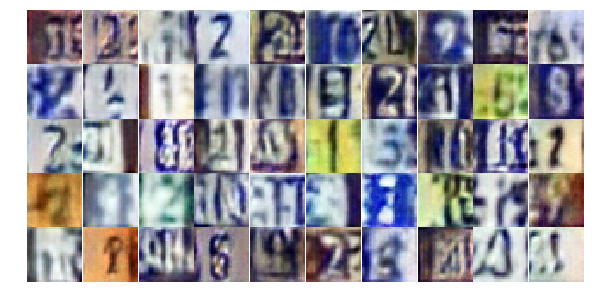

Epoch 9/20... Discriminator Loss: 1.0744... Generator Loss: 0.5860
Epoch 9/20... Discriminator Loss: 0.6819... Generator Loss: 1.3062
Epoch 9/20... Discriminator Loss: 1.0100... Generator Loss: 0.6916
Epoch 9/20... Discriminator Loss: 0.6841... Generator Loss: 1.0761
Epoch 9/20... Discriminator Loss: 1.4475... Generator Loss: 0.3444
Epoch 9/20... Discriminator Loss: 0.4426... Generator Loss: 1.8613
Epoch 9/20... Discriminator Loss: 0.6921... Generator Loss: 1.2979
Epoch 9/20... Discriminator Loss: 0.4991... Generator Loss: 2.2306
Epoch 9/20... Discriminator Loss: 1.4622... Generator Loss: 0.4726
Epoch 9/20... Discriminator Loss: 0.5450... Generator Loss: 1.4002


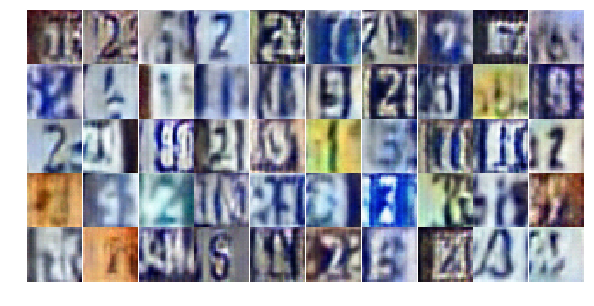

Epoch 9/20... Discriminator Loss: 0.9012... Generator Loss: 0.8034
Epoch 9/20... Discriminator Loss: 0.9239... Generator Loss: 2.2762
Epoch 9/20... Discriminator Loss: 0.8314... Generator Loss: 0.8394
Epoch 9/20... Discriminator Loss: 0.7953... Generator Loss: 0.8939
Epoch 9/20... Discriminator Loss: 0.5735... Generator Loss: 1.2598
Epoch 9/20... Discriminator Loss: 0.7544... Generator Loss: 0.9599
Epoch 9/20... Discriminator Loss: 1.0745... Generator Loss: 0.5820
Epoch 9/20... Discriminator Loss: 0.5114... Generator Loss: 1.3246
Epoch 9/20... Discriminator Loss: 1.2610... Generator Loss: 0.4718
Epoch 9/20... Discriminator Loss: 0.9943... Generator Loss: 0.6133


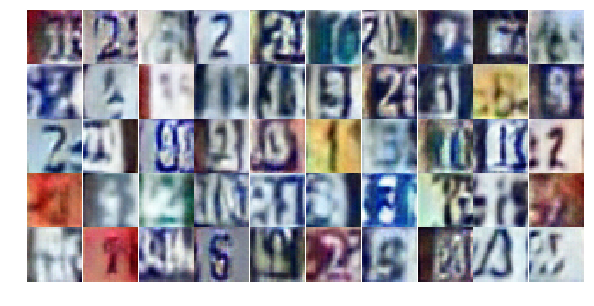

Epoch 9/20... Discriminator Loss: 0.8503... Generator Loss: 0.9234
Epoch 9/20... Discriminator Loss: 1.1053... Generator Loss: 0.5692
Epoch 9/20... Discriminator Loss: 0.5134... Generator Loss: 1.6117
Epoch 9/20... Discriminator Loss: 0.6813... Generator Loss: 1.0708
Epoch 9/20... Discriminator Loss: 0.5752... Generator Loss: 1.6772
Epoch 9/20... Discriminator Loss: 0.5121... Generator Loss: 1.9530
Epoch 9/20... Discriminator Loss: 1.4960... Generator Loss: 0.4423
Epoch 9/20... Discriminator Loss: 0.5800... Generator Loss: 1.6122
Epoch 9/20... Discriminator Loss: 0.6181... Generator Loss: 1.2634
Epoch 9/20... Discriminator Loss: 0.7913... Generator Loss: 0.8412


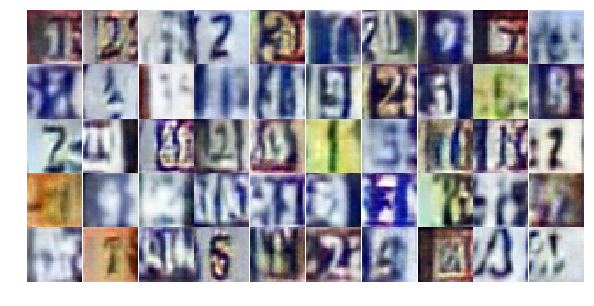

Epoch 9/20... Discriminator Loss: 0.4963... Generator Loss: 1.4102
Epoch 9/20... Discriminator Loss: 0.6416... Generator Loss: 1.1173
Epoch 9/20... Discriminator Loss: 1.0688... Generator Loss: 0.5867
Epoch 9/20... Discriminator Loss: 0.6033... Generator Loss: 1.1814
Epoch 9/20... Discriminator Loss: 0.7019... Generator Loss: 1.1351
Epoch 9/20... Discriminator Loss: 0.7586... Generator Loss: 0.9523
Epoch 9/20... Discriminator Loss: 0.5564... Generator Loss: 1.6572
Epoch 9/20... Discriminator Loss: 0.4192... Generator Loss: 1.5340
Epoch 9/20... Discriminator Loss: 1.3178... Generator Loss: 0.4088
Epoch 9/20... Discriminator Loss: 1.0845... Generator Loss: 0.5865


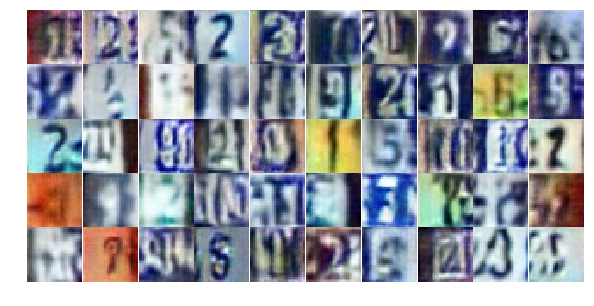

Epoch 9/20... Discriminator Loss: 0.4514... Generator Loss: 1.3309
Epoch 9/20... Discriminator Loss: 0.6178... Generator Loss: 1.1138
Epoch 9/20... Discriminator Loss: 0.9820... Generator Loss: 0.6863
Epoch 9/20... Discriminator Loss: 0.5661... Generator Loss: 1.6536
Epoch 9/20... Discriminator Loss: 0.4146... Generator Loss: 1.6989
Epoch 9/20... Discriminator Loss: 0.6755... Generator Loss: 1.1348
Epoch 9/20... Discriminator Loss: 0.5438... Generator Loss: 1.4316
Epoch 9/20... Discriminator Loss: 0.6004... Generator Loss: 1.0667
Epoch 9/20... Discriminator Loss: 0.6137... Generator Loss: 1.3148
Epoch 9/20... Discriminator Loss: 0.8469... Generator Loss: 2.9384


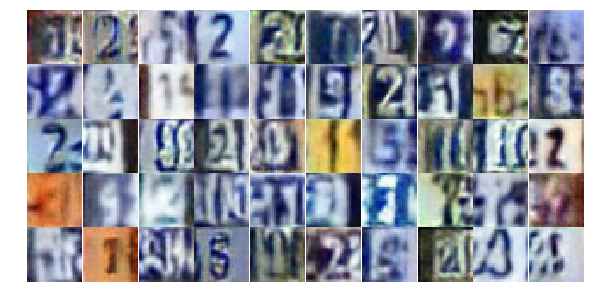

Epoch 9/20... Discriminator Loss: 0.8545... Generator Loss: 0.8002
Epoch 9/20... Discriminator Loss: 0.7787... Generator Loss: 2.0982
Epoch 9/20... Discriminator Loss: 1.1273... Generator Loss: 0.5370
Epoch 9/20... Discriminator Loss: 1.0631... Generator Loss: 0.5938
Epoch 9/20... Discriminator Loss: 0.4139... Generator Loss: 1.6047
Epoch 10/20... Discriminator Loss: 0.5718... Generator Loss: 1.1429
Epoch 10/20... Discriminator Loss: 0.5324... Generator Loss: 2.0834
Epoch 10/20... Discriminator Loss: 0.5265... Generator Loss: 1.9167
Epoch 10/20... Discriminator Loss: 0.6738... Generator Loss: 1.3386
Epoch 10/20... Discriminator Loss: 1.5863... Generator Loss: 0.3263


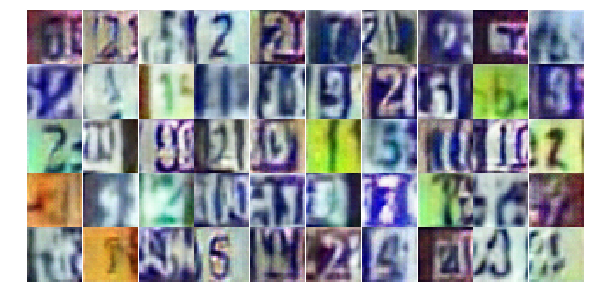

Epoch 10/20... Discriminator Loss: 0.7690... Generator Loss: 0.8462
Epoch 10/20... Discriminator Loss: 0.8830... Generator Loss: 0.9055
Epoch 10/20... Discriminator Loss: 0.6820... Generator Loss: 0.9579
Epoch 10/20... Discriminator Loss: 0.5884... Generator Loss: 1.2736
Epoch 10/20... Discriminator Loss: 0.5754... Generator Loss: 1.3267
Epoch 10/20... Discriminator Loss: 0.7211... Generator Loss: 1.0529
Epoch 10/20... Discriminator Loss: 0.5417... Generator Loss: 1.1524
Epoch 10/20... Discriminator Loss: 1.0045... Generator Loss: 0.6429
Epoch 10/20... Discriminator Loss: 0.7607... Generator Loss: 0.9201
Epoch 10/20... Discriminator Loss: 0.6023... Generator Loss: 1.1981


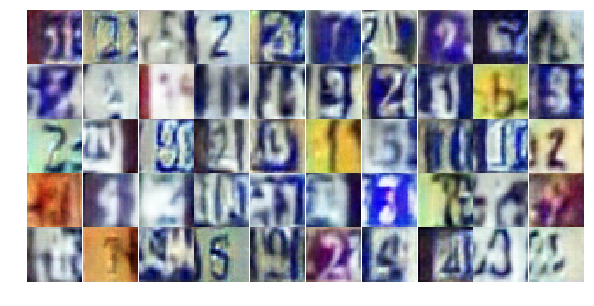

Epoch 10/20... Discriminator Loss: 0.9276... Generator Loss: 0.9297
Epoch 10/20... Discriminator Loss: 1.0838... Generator Loss: 0.6420
Epoch 10/20... Discriminator Loss: 0.7203... Generator Loss: 0.9501
Epoch 10/20... Discriminator Loss: 0.9324... Generator Loss: 0.6940
Epoch 10/20... Discriminator Loss: 0.5697... Generator Loss: 1.2929
Epoch 10/20... Discriminator Loss: 0.7099... Generator Loss: 0.9968
Epoch 10/20... Discriminator Loss: 0.8561... Generator Loss: 0.8557
Epoch 10/20... Discriminator Loss: 0.5118... Generator Loss: 2.0790
Epoch 10/20... Discriminator Loss: 0.7280... Generator Loss: 1.0431
Epoch 10/20... Discriminator Loss: 0.2790... Generator Loss: 2.1265


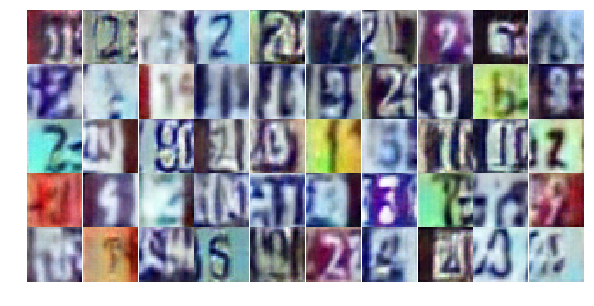

Epoch 10/20... Discriminator Loss: 1.2811... Generator Loss: 0.4147
Epoch 10/20... Discriminator Loss: 0.6961... Generator Loss: 1.0160
Epoch 10/20... Discriminator Loss: 0.4203... Generator Loss: 1.5218
Epoch 10/20... Discriminator Loss: 0.4761... Generator Loss: 2.1182
Epoch 10/20... Discriminator Loss: 1.2344... Generator Loss: 0.4176
Epoch 10/20... Discriminator Loss: 0.5627... Generator Loss: 1.3103
Epoch 10/20... Discriminator Loss: 0.3788... Generator Loss: 2.0721
Epoch 10/20... Discriminator Loss: 0.7593... Generator Loss: 0.9804
Epoch 10/20... Discriminator Loss: 0.7732... Generator Loss: 0.8355
Epoch 10/20... Discriminator Loss: 0.8374... Generator Loss: 0.9855


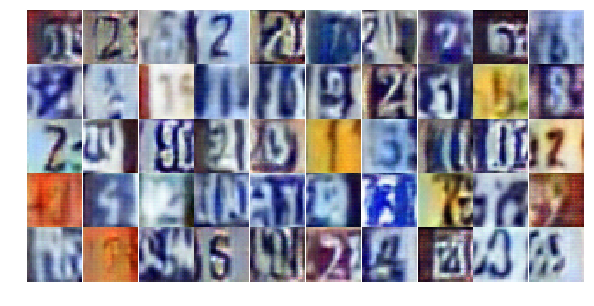

Epoch 10/20... Discriminator Loss: 0.5857... Generator Loss: 2.3693
Epoch 10/20... Discriminator Loss: 0.8394... Generator Loss: 0.8778
Epoch 10/20... Discriminator Loss: 0.7406... Generator Loss: 2.2494
Epoch 10/20... Discriminator Loss: 0.5995... Generator Loss: 1.6689
Epoch 10/20... Discriminator Loss: 0.6662... Generator Loss: 1.0974
Epoch 10/20... Discriminator Loss: 0.7629... Generator Loss: 0.8762
Epoch 10/20... Discriminator Loss: 1.2674... Generator Loss: 0.4849
Epoch 10/20... Discriminator Loss: 1.0478... Generator Loss: 0.6914
Epoch 10/20... Discriminator Loss: 0.6449... Generator Loss: 1.3330
Epoch 10/20... Discriminator Loss: 0.5518... Generator Loss: 2.6100


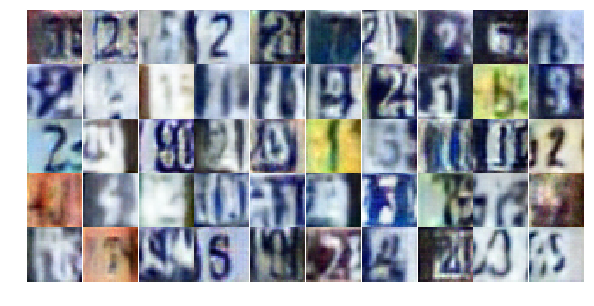

Epoch 10/20... Discriminator Loss: 0.7915... Generator Loss: 0.8747
Epoch 10/20... Discriminator Loss: 0.9104... Generator Loss: 0.7615
Epoch 10/20... Discriminator Loss: 0.5868... Generator Loss: 1.2406
Epoch 10/20... Discriminator Loss: 0.7427... Generator Loss: 0.9203
Epoch 10/20... Discriminator Loss: 0.6010... Generator Loss: 1.7232
Epoch 10/20... Discriminator Loss: 0.6815... Generator Loss: 1.2477
Epoch 10/20... Discriminator Loss: 0.7583... Generator Loss: 0.9282
Epoch 10/20... Discriminator Loss: 0.4480... Generator Loss: 1.6173
Epoch 10/20... Discriminator Loss: 1.6661... Generator Loss: 3.5953
Epoch 10/20... Discriminator Loss: 0.6136... Generator Loss: 1.1967


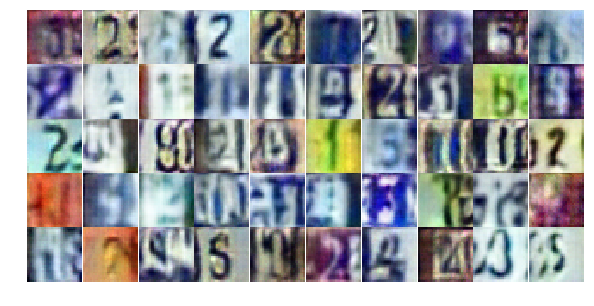

Epoch 10/20... Discriminator Loss: 0.6986... Generator Loss: 1.8505
Epoch 10/20... Discriminator Loss: 0.5023... Generator Loss: 1.4234
Epoch 10/20... Discriminator Loss: 0.5292... Generator Loss: 1.1882
Epoch 11/20... Discriminator Loss: 0.7780... Generator Loss: 0.9159
Epoch 11/20... Discriminator Loss: 0.5668... Generator Loss: 1.2956
Epoch 11/20... Discriminator Loss: 1.2210... Generator Loss: 0.4811
Epoch 11/20... Discriminator Loss: 0.7501... Generator Loss: 0.9361
Epoch 11/20... Discriminator Loss: 0.4604... Generator Loss: 1.4848
Epoch 11/20... Discriminator Loss: 1.9450... Generator Loss: 0.2295
Epoch 11/20... Discriminator Loss: 0.6109... Generator Loss: 1.6627


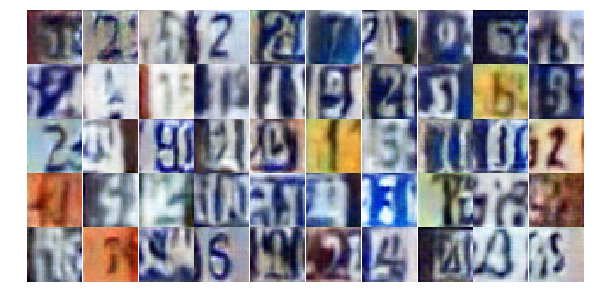

Epoch 11/20... Discriminator Loss: 0.4300... Generator Loss: 1.5671
Epoch 11/20... Discriminator Loss: 0.6883... Generator Loss: 1.0570
Epoch 11/20... Discriminator Loss: 0.4747... Generator Loss: 1.4112
Epoch 11/20... Discriminator Loss: 0.5184... Generator Loss: 1.4208
Epoch 11/20... Discriminator Loss: 0.7323... Generator Loss: 1.2031
Epoch 11/20... Discriminator Loss: 0.3834... Generator Loss: 1.8243
Epoch 11/20... Discriminator Loss: 0.6312... Generator Loss: 1.4408
Epoch 11/20... Discriminator Loss: 0.2771... Generator Loss: 2.3685
Epoch 11/20... Discriminator Loss: 0.7183... Generator Loss: 0.9603
Epoch 11/20... Discriminator Loss: 0.9628... Generator Loss: 1.7203


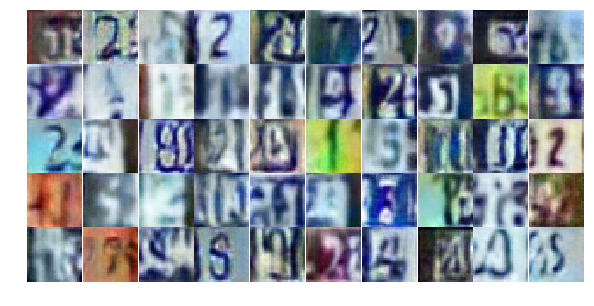

Epoch 11/20... Discriminator Loss: 1.1019... Generator Loss: 0.7019
Epoch 11/20... Discriminator Loss: 0.5647... Generator Loss: 1.3692
Epoch 11/20... Discriminator Loss: 0.9518... Generator Loss: 0.6364
Epoch 11/20... Discriminator Loss: 0.7379... Generator Loss: 0.8605
Epoch 11/20... Discriminator Loss: 0.3915... Generator Loss: 2.0186
Epoch 11/20... Discriminator Loss: 0.4581... Generator Loss: 1.7396
Epoch 11/20... Discriminator Loss: 0.5927... Generator Loss: 1.6144
Epoch 11/20... Discriminator Loss: 0.8707... Generator Loss: 0.8094
Epoch 11/20... Discriminator Loss: 0.4440... Generator Loss: 1.5001
Epoch 11/20... Discriminator Loss: 0.7083... Generator Loss: 0.9385


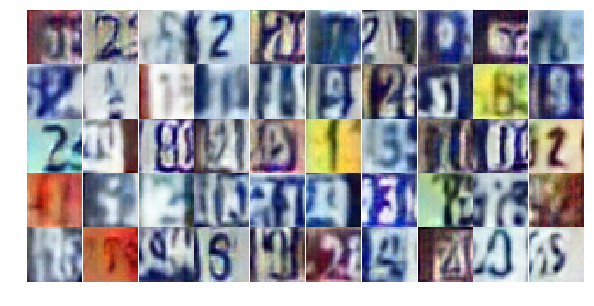

Epoch 11/20... Discriminator Loss: 0.9592... Generator Loss: 0.6895
Epoch 11/20... Discriminator Loss: 0.7218... Generator Loss: 1.0466
Epoch 11/20... Discriminator Loss: 1.4454... Generator Loss: 0.3724
Epoch 11/20... Discriminator Loss: 0.4347... Generator Loss: 1.5719
Epoch 11/20... Discriminator Loss: 0.6412... Generator Loss: 1.0159
Epoch 11/20... Discriminator Loss: 0.7914... Generator Loss: 0.7625
Epoch 11/20... Discriminator Loss: 1.3787... Generator Loss: 0.4510
Epoch 11/20... Discriminator Loss: 0.9502... Generator Loss: 0.8165
Epoch 11/20... Discriminator Loss: 0.6941... Generator Loss: 1.1122
Epoch 11/20... Discriminator Loss: 0.7419... Generator Loss: 1.0293


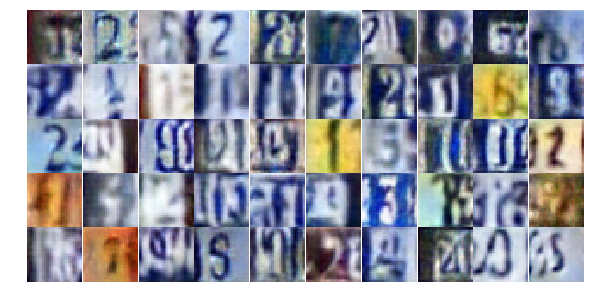

Epoch 11/20... Discriminator Loss: 0.5684... Generator Loss: 1.1506
Epoch 11/20... Discriminator Loss: 0.4595... Generator Loss: 1.3888
Epoch 11/20... Discriminator Loss: 0.6657... Generator Loss: 1.0734
Epoch 11/20... Discriminator Loss: 0.6963... Generator Loss: 1.0001
Epoch 11/20... Discriminator Loss: 0.8923... Generator Loss: 0.6673
Epoch 11/20... Discriminator Loss: 0.4773... Generator Loss: 1.2721
Epoch 11/20... Discriminator Loss: 0.2643... Generator Loss: 2.5291
Epoch 11/20... Discriminator Loss: 0.6697... Generator Loss: 1.0621
Epoch 11/20... Discriminator Loss: 1.4316... Generator Loss: 0.3850
Epoch 11/20... Discriminator Loss: 0.5454... Generator Loss: 1.2069


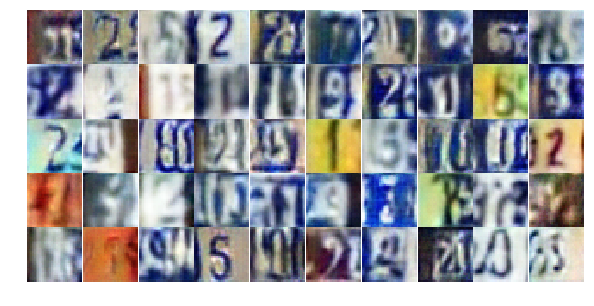

Epoch 11/20... Discriminator Loss: 0.7629... Generator Loss: 0.8765
Epoch 11/20... Discriminator Loss: 0.3703... Generator Loss: 1.9827
Epoch 11/20... Discriminator Loss: 0.7010... Generator Loss: 2.0826
Epoch 11/20... Discriminator Loss: 0.8856... Generator Loss: 0.7207
Epoch 11/20... Discriminator Loss: 2.0754... Generator Loss: 0.2307
Epoch 11/20... Discriminator Loss: 1.9037... Generator Loss: 0.2645
Epoch 11/20... Discriminator Loss: 0.8719... Generator Loss: 0.8983
Epoch 11/20... Discriminator Loss: 0.5448... Generator Loss: 1.6578
Epoch 11/20... Discriminator Loss: 0.7983... Generator Loss: 0.8465
Epoch 11/20... Discriminator Loss: 0.5712... Generator Loss: 1.3663


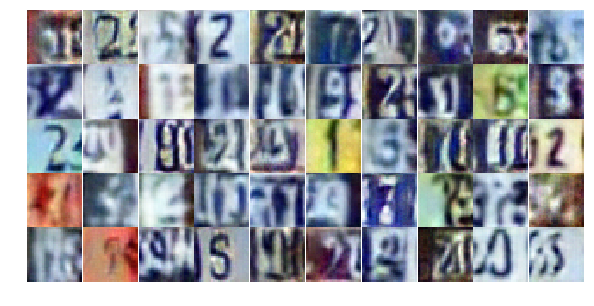

Epoch 12/20... Discriminator Loss: 0.6607... Generator Loss: 1.3141
Epoch 12/20... Discriminator Loss: 0.7048... Generator Loss: 1.2963
Epoch 12/20... Discriminator Loss: 0.7846... Generator Loss: 0.9598
Epoch 12/20... Discriminator Loss: 0.4851... Generator Loss: 1.6941
Epoch 12/20... Discriminator Loss: 0.5988... Generator Loss: 1.5849
Epoch 12/20... Discriminator Loss: 0.5423... Generator Loss: 1.1748
Epoch 12/20... Discriminator Loss: 0.6163... Generator Loss: 1.2135
Epoch 12/20... Discriminator Loss: 0.5056... Generator Loss: 1.5982
Epoch 12/20... Discriminator Loss: 0.6734... Generator Loss: 1.1787
Epoch 12/20... Discriminator Loss: 1.0839... Generator Loss: 0.5820


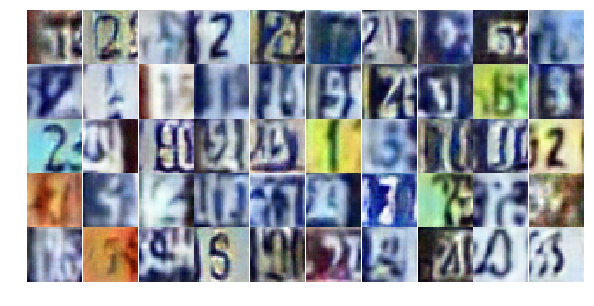

Epoch 12/20... Discriminator Loss: 0.5031... Generator Loss: 1.1909
Epoch 12/20... Discriminator Loss: 1.1320... Generator Loss: 0.5188
Epoch 12/20... Discriminator Loss: 1.5694... Generator Loss: 0.3843
Epoch 12/20... Discriminator Loss: 0.6653... Generator Loss: 1.4346
Epoch 12/20... Discriminator Loss: 0.5155... Generator Loss: 1.6841
Epoch 12/20... Discriminator Loss: 1.0933... Generator Loss: 0.5812
Epoch 12/20... Discriminator Loss: 1.5799... Generator Loss: 0.3229
Epoch 12/20... Discriminator Loss: 0.4273... Generator Loss: 1.8448
Epoch 12/20... Discriminator Loss: 0.5707... Generator Loss: 1.2341
Epoch 12/20... Discriminator Loss: 0.9691... Generator Loss: 0.6721


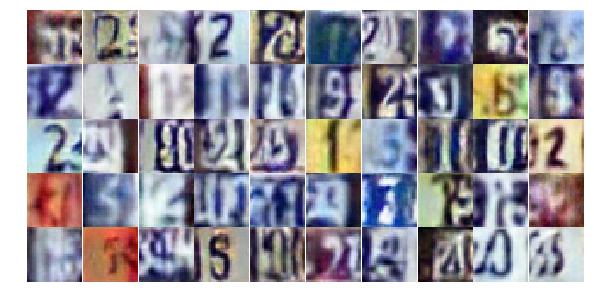

Epoch 12/20... Discriminator Loss: 0.4446... Generator Loss: 1.6276
Epoch 12/20... Discriminator Loss: 0.3135... Generator Loss: 2.0124
Epoch 12/20... Discriminator Loss: 0.6763... Generator Loss: 0.9680
Epoch 12/20... Discriminator Loss: 0.5589... Generator Loss: 1.4349
Epoch 12/20... Discriminator Loss: 0.3712... Generator Loss: 1.7417
Epoch 12/20... Discriminator Loss: 0.5657... Generator Loss: 1.1516
Epoch 12/20... Discriminator Loss: 0.5407... Generator Loss: 1.3107
Epoch 12/20... Discriminator Loss: 0.3557... Generator Loss: 1.9090
Epoch 12/20... Discriminator Loss: 0.5095... Generator Loss: 1.2168
Epoch 12/20... Discriminator Loss: 0.5952... Generator Loss: 1.2850


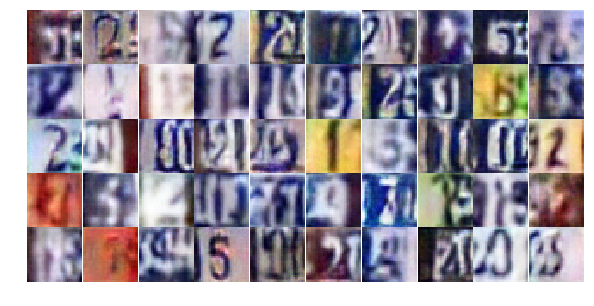

Epoch 12/20... Discriminator Loss: 0.5824... Generator Loss: 1.3684
Epoch 12/20... Discriminator Loss: 1.0142... Generator Loss: 0.6258
Epoch 12/20... Discriminator Loss: 1.0992... Generator Loss: 0.5686
Epoch 12/20... Discriminator Loss: 1.7206... Generator Loss: 0.2887
Epoch 12/20... Discriminator Loss: 0.6619... Generator Loss: 1.6348
Epoch 12/20... Discriminator Loss: 0.6757... Generator Loss: 0.9994
Epoch 12/20... Discriminator Loss: 1.0713... Generator Loss: 0.5486
Epoch 12/20... Discriminator Loss: 0.7119... Generator Loss: 0.9196
Epoch 12/20... Discriminator Loss: 0.4878... Generator Loss: 1.4539
Epoch 12/20... Discriminator Loss: 0.2989... Generator Loss: 1.7659


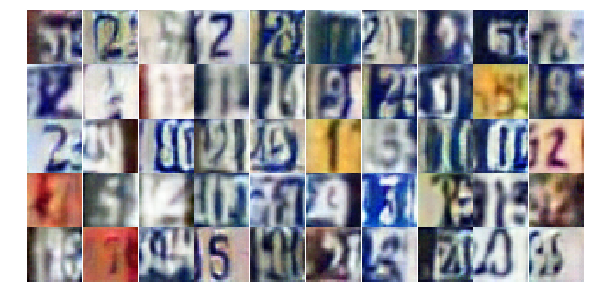

Epoch 12/20... Discriminator Loss: 0.6624... Generator Loss: 1.0019
Epoch 12/20... Discriminator Loss: 0.3978... Generator Loss: 1.6424
Epoch 12/20... Discriminator Loss: 0.3912... Generator Loss: 1.6999
Epoch 12/20... Discriminator Loss: 0.6504... Generator Loss: 1.8921
Epoch 12/20... Discriminator Loss: 1.8892... Generator Loss: 4.1545
Epoch 12/20... Discriminator Loss: 1.8556... Generator Loss: 0.3535
Epoch 12/20... Discriminator Loss: 0.7234... Generator Loss: 1.0588
Epoch 12/20... Discriminator Loss: 0.8265... Generator Loss: 0.9514
Epoch 12/20... Discriminator Loss: 0.4979... Generator Loss: 1.3636
Epoch 12/20... Discriminator Loss: 0.6572... Generator Loss: 1.0297


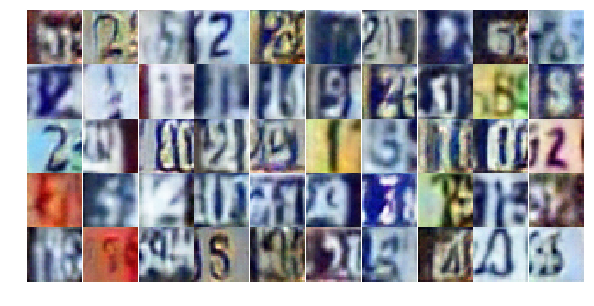

Epoch 12/20... Discriminator Loss: 0.6430... Generator Loss: 1.3491
Epoch 12/20... Discriminator Loss: 0.7689... Generator Loss: 0.9954
Epoch 12/20... Discriminator Loss: 0.5621... Generator Loss: 1.1623
Epoch 12/20... Discriminator Loss: 1.6214... Generator Loss: 0.2767
Epoch 12/20... Discriminator Loss: 0.5847... Generator Loss: 1.2752
Epoch 12/20... Discriminator Loss: 0.8200... Generator Loss: 2.6981
Epoch 12/20... Discriminator Loss: 0.7734... Generator Loss: 0.9059
Epoch 13/20... Discriminator Loss: 0.4383... Generator Loss: 1.4109
Epoch 13/20... Discriminator Loss: 0.4363... Generator Loss: 1.4449
Epoch 13/20... Discriminator Loss: 0.7527... Generator Loss: 0.9133


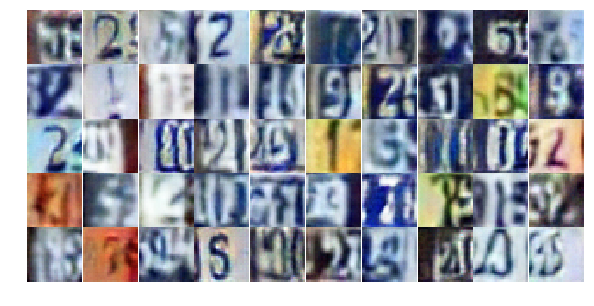

Epoch 13/20... Discriminator Loss: 0.4860... Generator Loss: 1.2500
Epoch 13/20... Discriminator Loss: 0.7229... Generator Loss: 2.3989
Epoch 13/20... Discriminator Loss: 1.0150... Generator Loss: 0.6632
Epoch 13/20... Discriminator Loss: 2.0730... Generator Loss: 0.2043
Epoch 13/20... Discriminator Loss: 0.8086... Generator Loss: 1.0135
Epoch 13/20... Discriminator Loss: 0.5751... Generator Loss: 1.1845
Epoch 13/20... Discriminator Loss: 0.3595... Generator Loss: 1.8528
Epoch 13/20... Discriminator Loss: 0.5147... Generator Loss: 1.2260
Epoch 13/20... Discriminator Loss: 0.4726... Generator Loss: 1.3346
Epoch 13/20... Discriminator Loss: 0.6924... Generator Loss: 0.9830


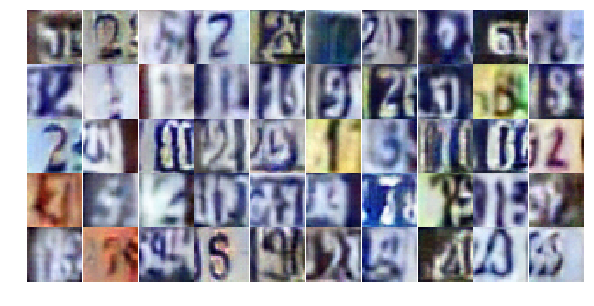

Epoch 13/20... Discriminator Loss: 0.4841... Generator Loss: 1.3805
Epoch 13/20... Discriminator Loss: 0.4273... Generator Loss: 1.5166
Epoch 13/20... Discriminator Loss: 1.0902... Generator Loss: 0.6432
Epoch 13/20... Discriminator Loss: 0.8390... Generator Loss: 0.9291
Epoch 13/20... Discriminator Loss: 0.6022... Generator Loss: 1.1800
Epoch 13/20... Discriminator Loss: 0.7926... Generator Loss: 0.8994
Epoch 13/20... Discriminator Loss: 0.5795... Generator Loss: 1.2778
Epoch 13/20... Discriminator Loss: 0.7473... Generator Loss: 0.8301
Epoch 13/20... Discriminator Loss: 0.7243... Generator Loss: 0.9469
Epoch 13/20... Discriminator Loss: 0.8619... Generator Loss: 0.7101


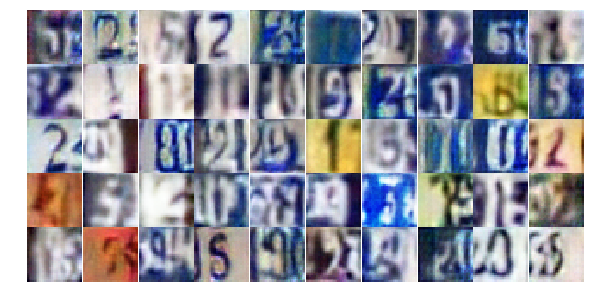

Epoch 13/20... Discriminator Loss: 0.5401... Generator Loss: 1.4292
Epoch 13/20... Discriminator Loss: 0.7364... Generator Loss: 0.9361
Epoch 13/20... Discriminator Loss: 0.6022... Generator Loss: 1.6894
Epoch 13/20... Discriminator Loss: 0.8208... Generator Loss: 0.8248
Epoch 13/20... Discriminator Loss: 0.6753... Generator Loss: 1.0886
Epoch 13/20... Discriminator Loss: 0.6342... Generator Loss: 1.8715
Epoch 13/20... Discriminator Loss: 0.8500... Generator Loss: 1.8449
Epoch 13/20... Discriminator Loss: 0.4469... Generator Loss: 1.3969
Epoch 13/20... Discriminator Loss: 0.6047... Generator Loss: 1.0686
Epoch 13/20... Discriminator Loss: 0.4442... Generator Loss: 1.7288


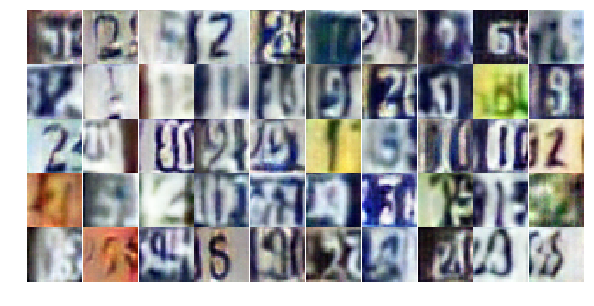

Epoch 13/20... Discriminator Loss: 1.0587... Generator Loss: 0.6168
Epoch 13/20... Discriminator Loss: 0.7009... Generator Loss: 1.3611
Epoch 13/20... Discriminator Loss: 1.9221... Generator Loss: 0.2545
Epoch 13/20... Discriminator Loss: 1.0931... Generator Loss: 0.5533
Epoch 13/20... Discriminator Loss: 0.6898... Generator Loss: 0.9846
Epoch 13/20... Discriminator Loss: 0.4543... Generator Loss: 1.7530
Epoch 13/20... Discriminator Loss: 0.4426... Generator Loss: 1.4239
Epoch 13/20... Discriminator Loss: 0.7907... Generator Loss: 0.9952
Epoch 13/20... Discriminator Loss: 0.4926... Generator Loss: 1.4171
Epoch 13/20... Discriminator Loss: 0.7176... Generator Loss: 0.8852


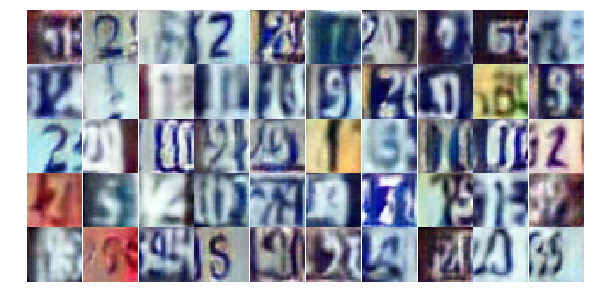

Epoch 13/20... Discriminator Loss: 0.7446... Generator Loss: 0.9052
Epoch 13/20... Discriminator Loss: 0.8933... Generator Loss: 0.9658
Epoch 13/20... Discriminator Loss: 0.9269... Generator Loss: 0.7115
Epoch 13/20... Discriminator Loss: 0.5610... Generator Loss: 1.1717
Epoch 13/20... Discriminator Loss: 1.0283... Generator Loss: 0.6056
Epoch 13/20... Discriminator Loss: 0.5657... Generator Loss: 1.2463
Epoch 13/20... Discriminator Loss: 1.0078... Generator Loss: 0.6732
Epoch 13/20... Discriminator Loss: 0.5810... Generator Loss: 1.1568
Epoch 13/20... Discriminator Loss: 0.7204... Generator Loss: 0.8917
Epoch 13/20... Discriminator Loss: 1.5598... Generator Loss: 0.3451


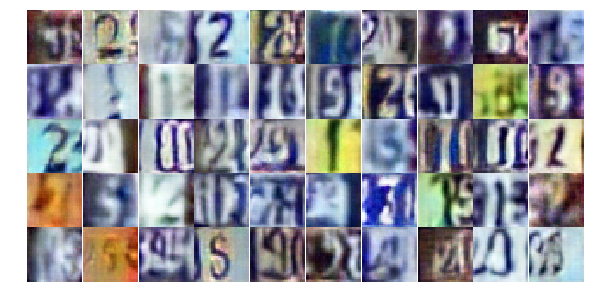

Epoch 13/20... Discriminator Loss: 0.2794... Generator Loss: 2.1797
Epoch 13/20... Discriminator Loss: 1.7086... Generator Loss: 0.2648
Epoch 13/20... Discriminator Loss: 0.6331... Generator Loss: 1.1381
Epoch 13/20... Discriminator Loss: 0.8074... Generator Loss: 0.8063
Epoch 14/20... Discriminator Loss: 1.2065... Generator Loss: 0.5291
Epoch 14/20... Discriminator Loss: 0.5997... Generator Loss: 1.1941
Epoch 14/20... Discriminator Loss: 1.0857... Generator Loss: 0.6123
Epoch 14/20... Discriminator Loss: 0.6083... Generator Loss: 1.2417
Epoch 14/20... Discriminator Loss: 0.4932... Generator Loss: 1.5008
Epoch 14/20... Discriminator Loss: 0.6365... Generator Loss: 1.1283


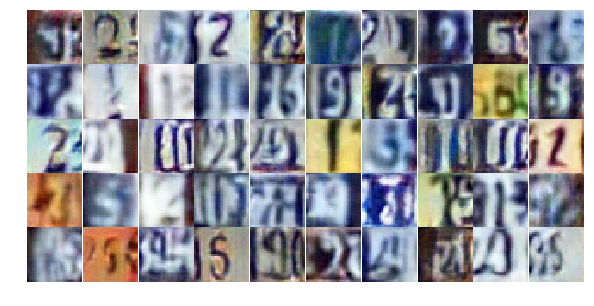

Epoch 14/20... Discriminator Loss: 0.6328... Generator Loss: 2.1688
Epoch 14/20... Discriminator Loss: 0.9016... Generator Loss: 0.7019
Epoch 14/20... Discriminator Loss: 0.5345... Generator Loss: 1.2134
Epoch 14/20... Discriminator Loss: 0.7075... Generator Loss: 1.0696
Epoch 14/20... Discriminator Loss: 1.1661... Generator Loss: 0.5103
Epoch 14/20... Discriminator Loss: 0.4885... Generator Loss: 1.2392
Epoch 14/20... Discriminator Loss: 0.4654... Generator Loss: 1.9001
Epoch 14/20... Discriminator Loss: 1.4034... Generator Loss: 0.4048
Epoch 14/20... Discriminator Loss: 0.9914... Generator Loss: 0.6808
Epoch 14/20... Discriminator Loss: 1.3195... Generator Loss: 0.4288


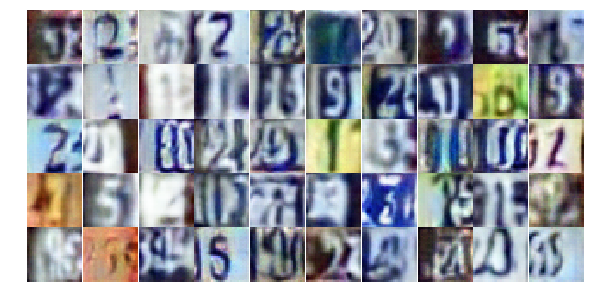

Epoch 14/20... Discriminator Loss: 0.5375... Generator Loss: 4.0008
Epoch 14/20... Discriminator Loss: 0.5919... Generator Loss: 2.1895
Epoch 14/20... Discriminator Loss: 0.9453... Generator Loss: 0.6999
Epoch 14/20... Discriminator Loss: 0.6273... Generator Loss: 1.0633
Epoch 14/20... Discriminator Loss: 0.6704... Generator Loss: 1.1779
Epoch 14/20... Discriminator Loss: 0.8808... Generator Loss: 0.8755
Epoch 14/20... Discriminator Loss: 0.9641... Generator Loss: 0.7054
Epoch 14/20... Discriminator Loss: 0.6337... Generator Loss: 1.0973
Epoch 14/20... Discriminator Loss: 0.5129... Generator Loss: 1.2965
Epoch 14/20... Discriminator Loss: 0.6287... Generator Loss: 1.1951


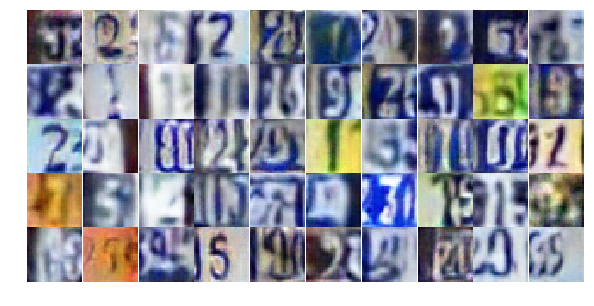

Epoch 14/20... Discriminator Loss: 1.1134... Generator Loss: 0.6426
Epoch 14/20... Discriminator Loss: 0.4729... Generator Loss: 1.4462
Epoch 14/20... Discriminator Loss: 0.4137... Generator Loss: 1.8186
Epoch 14/20... Discriminator Loss: 0.4173... Generator Loss: 1.4152
Epoch 14/20... Discriminator Loss: 0.4995... Generator Loss: 1.4394
Epoch 14/20... Discriminator Loss: 0.4035... Generator Loss: 1.6507
Epoch 14/20... Discriminator Loss: 0.7447... Generator Loss: 0.8713
Epoch 14/20... Discriminator Loss: 0.4099... Generator Loss: 1.5030
Epoch 14/20... Discriminator Loss: 0.3854... Generator Loss: 2.0959
Epoch 14/20... Discriminator Loss: 0.8888... Generator Loss: 1.0606


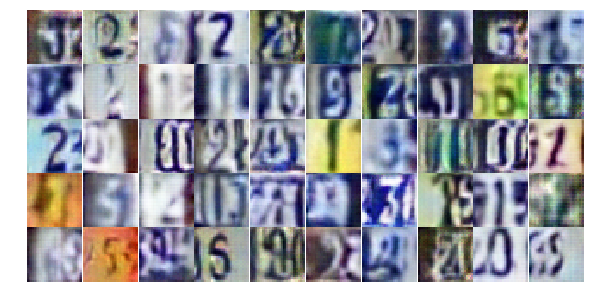

Epoch 14/20... Discriminator Loss: 0.7736... Generator Loss: 0.9448
Epoch 14/20... Discriminator Loss: 0.5842... Generator Loss: 1.4510
Epoch 14/20... Discriminator Loss: 0.9512... Generator Loss: 0.6592
Epoch 14/20... Discriminator Loss: 0.7391... Generator Loss: 0.8469
Epoch 14/20... Discriminator Loss: 0.7524... Generator Loss: 0.8884
Epoch 14/20... Discriminator Loss: 0.6429... Generator Loss: 1.7974
Epoch 14/20... Discriminator Loss: 0.5659... Generator Loss: 1.2291
Epoch 14/20... Discriminator Loss: 0.5546... Generator Loss: 1.1227
Epoch 14/20... Discriminator Loss: 0.9075... Generator Loss: 0.8739
Epoch 14/20... Discriminator Loss: 1.0864... Generator Loss: 0.5862


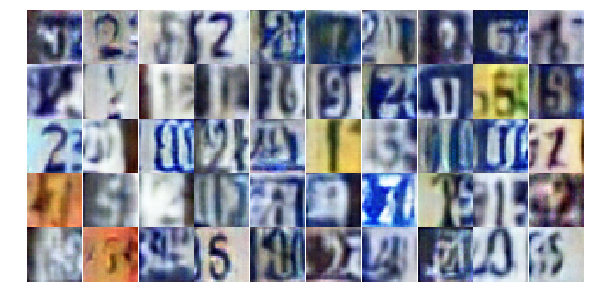

Epoch 14/20... Discriminator Loss: 1.1130... Generator Loss: 2.9751
Epoch 14/20... Discriminator Loss: 1.1028... Generator Loss: 0.5830
Epoch 14/20... Discriminator Loss: 0.6180... Generator Loss: 1.2886
Epoch 14/20... Discriminator Loss: 1.4986... Generator Loss: 0.3586
Epoch 14/20... Discriminator Loss: 0.5244... Generator Loss: 1.4235
Epoch 14/20... Discriminator Loss: 0.6288... Generator Loss: 1.3408
Epoch 14/20... Discriminator Loss: 0.7779... Generator Loss: 0.9645
Epoch 14/20... Discriminator Loss: 0.6502... Generator Loss: 1.1411
Epoch 14/20... Discriminator Loss: 0.7241... Generator Loss: 1.1957
Epoch 14/20... Discriminator Loss: 1.0416... Generator Loss: 0.6145


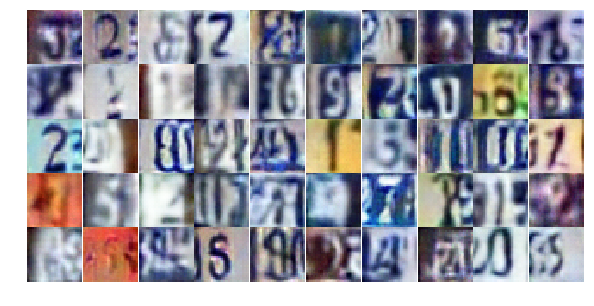

Epoch 14/20... Discriminator Loss: 0.8231... Generator Loss: 0.8804
Epoch 14/20... Discriminator Loss: 1.0711... Generator Loss: 0.6712
Epoch 15/20... Discriminator Loss: 0.7207... Generator Loss: 0.9312
Epoch 15/20... Discriminator Loss: 0.4728... Generator Loss: 1.6724
Epoch 15/20... Discriminator Loss: 0.4269... Generator Loss: 1.8733
Epoch 15/20... Discriminator Loss: 0.7949... Generator Loss: 0.7990
Epoch 15/20... Discriminator Loss: 1.3763... Generator Loss: 0.4543
Epoch 15/20... Discriminator Loss: 0.5881... Generator Loss: 1.3293
Epoch 15/20... Discriminator Loss: 0.9003... Generator Loss: 0.7463
Epoch 15/20... Discriminator Loss: 0.6470... Generator Loss: 1.1583


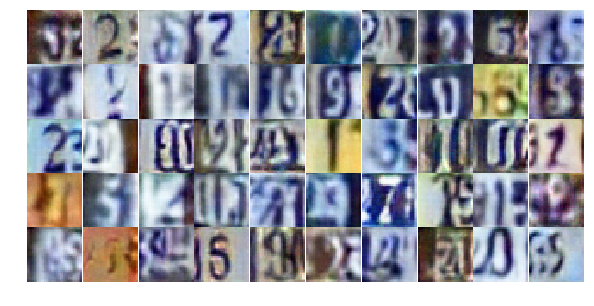

Epoch 15/20... Discriminator Loss: 0.6887... Generator Loss: 0.9083
Epoch 15/20... Discriminator Loss: 0.6346... Generator Loss: 1.9937
Epoch 15/20... Discriminator Loss: 0.6737... Generator Loss: 1.1158
Epoch 15/20... Discriminator Loss: 0.5692... Generator Loss: 1.3220
Epoch 15/20... Discriminator Loss: 0.7757... Generator Loss: 0.8947
Epoch 15/20... Discriminator Loss: 0.5413... Generator Loss: 1.2268
Epoch 15/20... Discriminator Loss: 1.1572... Generator Loss: 0.5015
Epoch 15/20... Discriminator Loss: 0.5471... Generator Loss: 1.5147
Epoch 15/20... Discriminator Loss: 0.9439... Generator Loss: 2.9514
Epoch 15/20... Discriminator Loss: 1.4986... Generator Loss: 0.4204


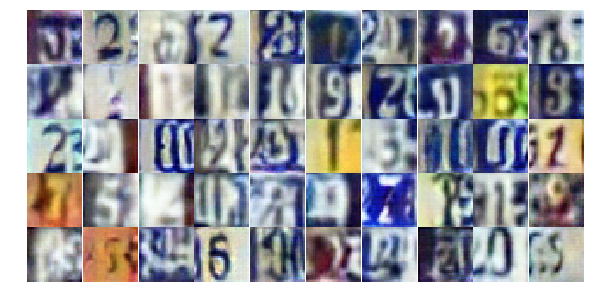

Epoch 15/20... Discriminator Loss: 0.7064... Generator Loss: 1.1566
Epoch 15/20... Discriminator Loss: 0.7097... Generator Loss: 0.9555
Epoch 15/20... Discriminator Loss: 0.4677... Generator Loss: 1.6004
Epoch 15/20... Discriminator Loss: 1.1260... Generator Loss: 0.5691
Epoch 15/20... Discriminator Loss: 0.6058... Generator Loss: 1.3167
Epoch 15/20... Discriminator Loss: 0.5674... Generator Loss: 1.3473
Epoch 15/20... Discriminator Loss: 0.8686... Generator Loss: 0.7400
Epoch 15/20... Discriminator Loss: 0.7600... Generator Loss: 0.9163
Epoch 15/20... Discriminator Loss: 0.5571... Generator Loss: 1.1853
Epoch 15/20... Discriminator Loss: 0.8269... Generator Loss: 0.8120


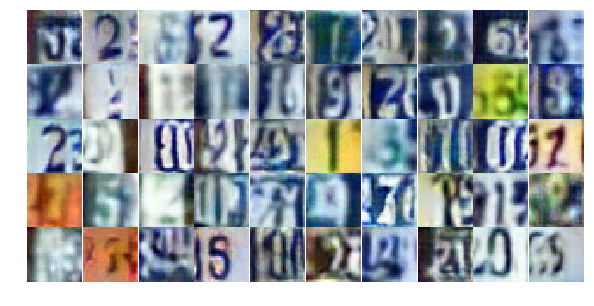

Epoch 15/20... Discriminator Loss: 0.8036... Generator Loss: 0.7778
Epoch 15/20... Discriminator Loss: 0.7298... Generator Loss: 0.9225
Epoch 15/20... Discriminator Loss: 0.4285... Generator Loss: 1.3957
Epoch 15/20... Discriminator Loss: 0.7691... Generator Loss: 0.9028
Epoch 15/20... Discriminator Loss: 0.4607... Generator Loss: 1.6474
Epoch 15/20... Discriminator Loss: 1.1112... Generator Loss: 2.8337
Epoch 15/20... Discriminator Loss: 0.6955... Generator Loss: 0.9859
Epoch 15/20... Discriminator Loss: 0.6987... Generator Loss: 1.0335
Epoch 15/20... Discriminator Loss: 0.4054... Generator Loss: 1.4384
Epoch 15/20... Discriminator Loss: 0.5699... Generator Loss: 1.5547


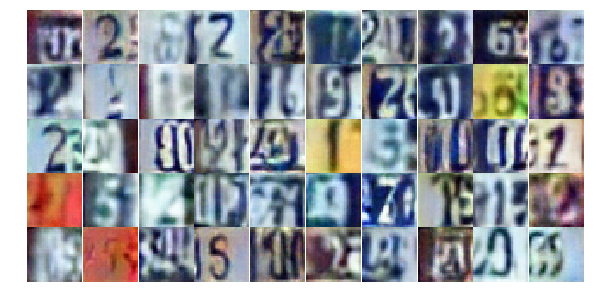

Epoch 15/20... Discriminator Loss: 0.7041... Generator Loss: 0.9311
Epoch 15/20... Discriminator Loss: 0.7809... Generator Loss: 0.8363
Epoch 15/20... Discriminator Loss: 0.6529... Generator Loss: 1.0565
Epoch 15/20... Discriminator Loss: 0.5227... Generator Loss: 1.2263
Epoch 15/20... Discriminator Loss: 0.8386... Generator Loss: 0.8244
Epoch 15/20... Discriminator Loss: 1.3339... Generator Loss: 0.4869
Epoch 15/20... Discriminator Loss: 0.4461... Generator Loss: 1.3635
Epoch 15/20... Discriminator Loss: 0.6649... Generator Loss: 1.1325
Epoch 15/20... Discriminator Loss: 0.6141... Generator Loss: 1.0783
Epoch 15/20... Discriminator Loss: 0.6447... Generator Loss: 1.7255


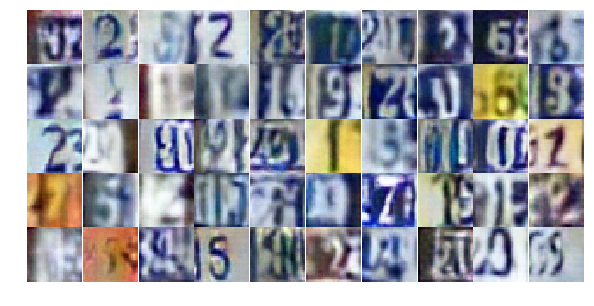

Epoch 15/20... Discriminator Loss: 1.6809... Generator Loss: 0.2940
Epoch 15/20... Discriminator Loss: 1.9810... Generator Loss: 0.2197
Epoch 15/20... Discriminator Loss: 0.5153... Generator Loss: 1.8268
Epoch 15/20... Discriminator Loss: 0.6743... Generator Loss: 0.9668
Epoch 15/20... Discriminator Loss: 0.6366... Generator Loss: 1.1144
Epoch 15/20... Discriminator Loss: 1.8383... Generator Loss: 3.4027
Epoch 15/20... Discriminator Loss: 1.4514... Generator Loss: 0.4736
Epoch 15/20... Discriminator Loss: 0.6587... Generator Loss: 1.1317
Epoch 15/20... Discriminator Loss: 1.4223... Generator Loss: 0.4307
Epoch 16/20... Discriminator Loss: 0.9277... Generator Loss: 0.7653


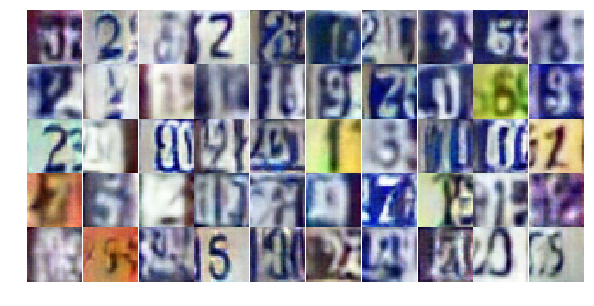

Epoch 16/20... Discriminator Loss: 0.6782... Generator Loss: 1.0303
Epoch 16/20... Discriminator Loss: 0.7146... Generator Loss: 1.2805
Epoch 16/20... Discriminator Loss: 0.6979... Generator Loss: 0.9484
Epoch 16/20... Discriminator Loss: 0.6930... Generator Loss: 1.0375
Epoch 16/20... Discriminator Loss: 0.5643... Generator Loss: 1.2760
Epoch 16/20... Discriminator Loss: 0.6078... Generator Loss: 1.2592
Epoch 16/20... Discriminator Loss: 1.7149... Generator Loss: 0.2857
Epoch 16/20... Discriminator Loss: 1.1307... Generator Loss: 0.6303
Epoch 16/20... Discriminator Loss: 0.8402... Generator Loss: 0.9018
Epoch 16/20... Discriminator Loss: 0.5784... Generator Loss: 1.1617


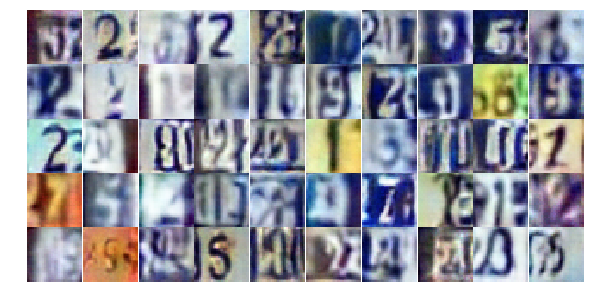

Epoch 16/20... Discriminator Loss: 1.0695... Generator Loss: 0.6048
Epoch 16/20... Discriminator Loss: 0.6409... Generator Loss: 1.1382
Epoch 16/20... Discriminator Loss: 0.6464... Generator Loss: 1.2794
Epoch 16/20... Discriminator Loss: 1.4031... Generator Loss: 0.3798
Epoch 16/20... Discriminator Loss: 0.3862... Generator Loss: 1.6407
Epoch 16/20... Discriminator Loss: 0.6001... Generator Loss: 1.3791
Epoch 16/20... Discriminator Loss: 1.5589... Generator Loss: 0.3573
Epoch 16/20... Discriminator Loss: 0.5303... Generator Loss: 2.0945
Epoch 16/20... Discriminator Loss: 0.4459... Generator Loss: 1.4372
Epoch 16/20... Discriminator Loss: 0.5235... Generator Loss: 1.5845


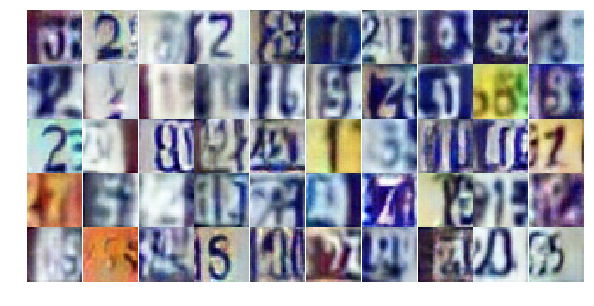

Epoch 16/20... Discriminator Loss: 0.6468... Generator Loss: 1.0546
Epoch 16/20... Discriminator Loss: 0.5558... Generator Loss: 1.6082
Epoch 16/20... Discriminator Loss: 0.7625... Generator Loss: 0.9025
Epoch 16/20... Discriminator Loss: 0.8358... Generator Loss: 0.8210
Epoch 16/20... Discriminator Loss: 0.8204... Generator Loss: 0.8997
Epoch 16/20... Discriminator Loss: 0.8117... Generator Loss: 0.8455
Epoch 16/20... Discriminator Loss: 0.7279... Generator Loss: 0.8840
Epoch 16/20... Discriminator Loss: 0.4918... Generator Loss: 1.4821
Epoch 16/20... Discriminator Loss: 0.6550... Generator Loss: 1.1244
Epoch 16/20... Discriminator Loss: 0.4948... Generator Loss: 1.3157


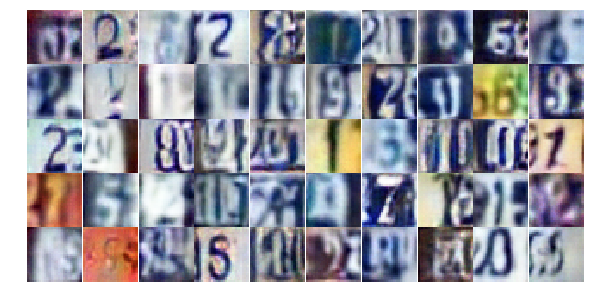

Epoch 16/20... Discriminator Loss: 0.5217... Generator Loss: 1.2434
Epoch 16/20... Discriminator Loss: 0.5899... Generator Loss: 1.1183
Epoch 16/20... Discriminator Loss: 0.5374... Generator Loss: 2.2565
Epoch 16/20... Discriminator Loss: 0.5289... Generator Loss: 2.3512
Epoch 16/20... Discriminator Loss: 1.1408... Generator Loss: 1.8879
Epoch 16/20... Discriminator Loss: 0.6266... Generator Loss: 1.5134
Epoch 16/20... Discriminator Loss: 1.2056... Generator Loss: 0.4765
Epoch 16/20... Discriminator Loss: 1.1632... Generator Loss: 0.5515
Epoch 16/20... Discriminator Loss: 0.9127... Generator Loss: 0.7489
Epoch 16/20... Discriminator Loss: 0.4474... Generator Loss: 1.8810


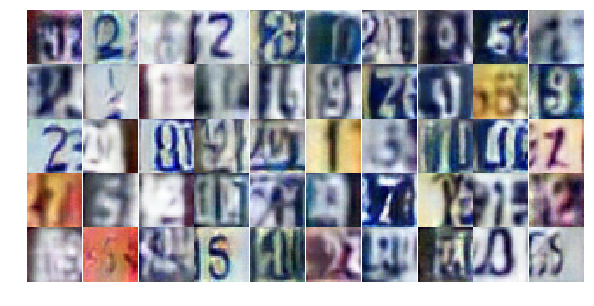

Epoch 16/20... Discriminator Loss: 0.5110... Generator Loss: 1.3942
Epoch 16/20... Discriminator Loss: 0.6459... Generator Loss: 1.3822
Epoch 16/20... Discriminator Loss: 1.2283... Generator Loss: 0.4827
Epoch 16/20... Discriminator Loss: 2.3615... Generator Loss: 0.3873
Epoch 16/20... Discriminator Loss: 0.6647... Generator Loss: 1.2602
Epoch 16/20... Discriminator Loss: 0.8195... Generator Loss: 0.8478
Epoch 16/20... Discriminator Loss: 0.4723... Generator Loss: 1.4088
Epoch 16/20... Discriminator Loss: 0.9341... Generator Loss: 0.7108
Epoch 16/20... Discriminator Loss: 0.4533... Generator Loss: 1.4087
Epoch 16/20... Discriminator Loss: 0.6527... Generator Loss: 1.1340


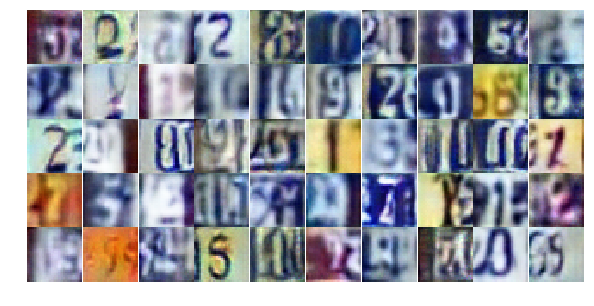

Epoch 16/20... Discriminator Loss: 1.1766... Generator Loss: 0.4972
Epoch 16/20... Discriminator Loss: 0.4870... Generator Loss: 2.3879
Epoch 16/20... Discriminator Loss: 1.2081... Generator Loss: 0.5260
Epoch 16/20... Discriminator Loss: 0.4478... Generator Loss: 1.7068
Epoch 16/20... Discriminator Loss: 0.4337... Generator Loss: 1.5646
Epoch 16/20... Discriminator Loss: 0.7963... Generator Loss: 0.9450
Epoch 17/20... Discriminator Loss: 0.7297... Generator Loss: 2.2103
Epoch 17/20... Discriminator Loss: 0.7974... Generator Loss: 0.8521
Epoch 17/20... Discriminator Loss: 0.7136... Generator Loss: 0.9978
Epoch 17/20... Discriminator Loss: 1.0575... Generator Loss: 0.6709


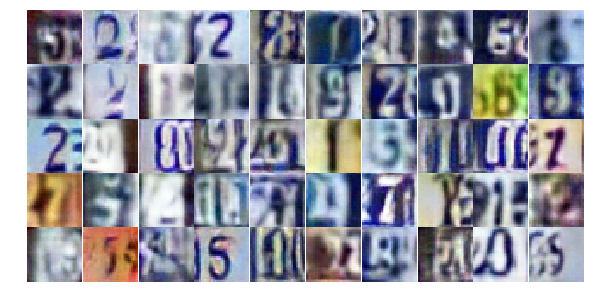

Epoch 17/20... Discriminator Loss: 0.5315... Generator Loss: 1.3618
Epoch 17/20... Discriminator Loss: 0.5343... Generator Loss: 1.2735
Epoch 17/20... Discriminator Loss: 0.6593... Generator Loss: 1.1995
Epoch 17/20... Discriminator Loss: 0.7666... Generator Loss: 0.8319
Epoch 17/20... Discriminator Loss: 1.2813... Generator Loss: 0.4436
Epoch 17/20... Discriminator Loss: 1.0084... Generator Loss: 0.6073
Epoch 17/20... Discriminator Loss: 0.7515... Generator Loss: 0.9261
Epoch 17/20... Discriminator Loss: 0.5161... Generator Loss: 1.1792
Epoch 17/20... Discriminator Loss: 0.2913... Generator Loss: 2.3691
Epoch 17/20... Discriminator Loss: 0.6212... Generator Loss: 2.4436


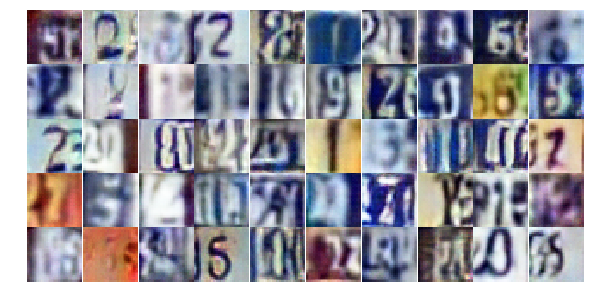

Epoch 17/20... Discriminator Loss: 0.8505... Generator Loss: 1.3603
Epoch 17/20... Discriminator Loss: 0.8524... Generator Loss: 0.7985
Epoch 17/20... Discriminator Loss: 0.4804... Generator Loss: 1.3524
Epoch 17/20... Discriminator Loss: 0.6965... Generator Loss: 1.2415
Epoch 17/20... Discriminator Loss: 0.4926... Generator Loss: 1.3515
Epoch 17/20... Discriminator Loss: 0.9942... Generator Loss: 0.6507
Epoch 17/20... Discriminator Loss: 0.5156... Generator Loss: 3.1928
Epoch 17/20... Discriminator Loss: 0.4345... Generator Loss: 1.9138
Epoch 17/20... Discriminator Loss: 0.4539... Generator Loss: 1.5487
Epoch 17/20... Discriminator Loss: 0.4909... Generator Loss: 1.2197


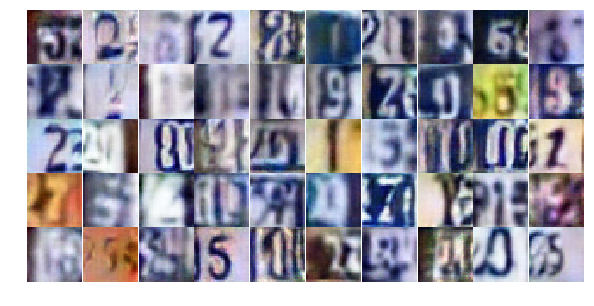

Epoch 17/20... Discriminator Loss: 1.5022... Generator Loss: 0.3659
Epoch 17/20... Discriminator Loss: 0.4831... Generator Loss: 1.4037
Epoch 17/20... Discriminator Loss: 0.4024... Generator Loss: 2.1577
Epoch 17/20... Discriminator Loss: 1.0240... Generator Loss: 0.5931
Epoch 17/20... Discriminator Loss: 1.4737... Generator Loss: 0.4060
Epoch 17/20... Discriminator Loss: 0.3783... Generator Loss: 1.6380
Epoch 17/20... Discriminator Loss: 0.6763... Generator Loss: 1.0073
Epoch 17/20... Discriminator Loss: 1.1021... Generator Loss: 0.5558
Epoch 17/20... Discriminator Loss: 0.7364... Generator Loss: 1.0243
Epoch 17/20... Discriminator Loss: 0.2477... Generator Loss: 2.5596


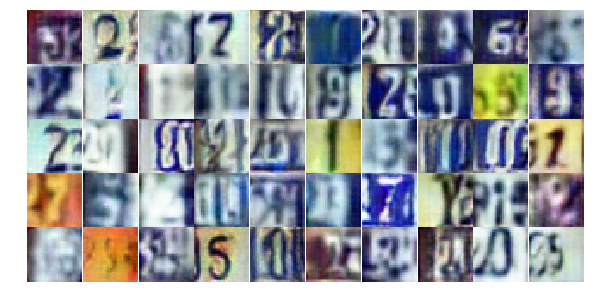

Epoch 17/20... Discriminator Loss: 0.8864... Generator Loss: 0.8459
Epoch 17/20... Discriminator Loss: 0.8595... Generator Loss: 1.5085
Epoch 17/20... Discriminator Loss: 0.5586... Generator Loss: 1.4143
Epoch 17/20... Discriminator Loss: 1.1847... Generator Loss: 0.5018
Epoch 17/20... Discriminator Loss: 0.9564... Generator Loss: 0.6973
Epoch 17/20... Discriminator Loss: 0.7504... Generator Loss: 0.9843
Epoch 17/20... Discriminator Loss: 0.6203... Generator Loss: 1.4892
Epoch 17/20... Discriminator Loss: 0.4501... Generator Loss: 1.4623
Epoch 17/20... Discriminator Loss: 0.5048... Generator Loss: 1.9336
Epoch 17/20... Discriminator Loss: 0.8355... Generator Loss: 0.7504


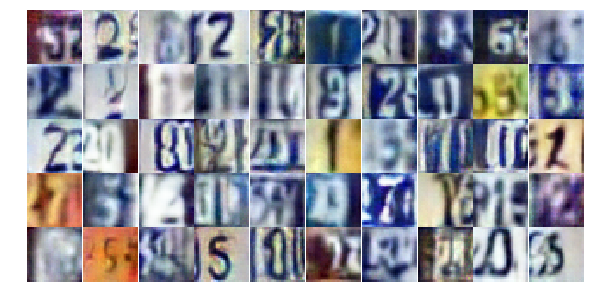

Epoch 17/20... Discriminator Loss: 1.4100... Generator Loss: 0.4361
Epoch 17/20... Discriminator Loss: 0.2827... Generator Loss: 2.2045
Epoch 17/20... Discriminator Loss: 0.6436... Generator Loss: 1.1697
Epoch 17/20... Discriminator Loss: 0.4336... Generator Loss: 1.8891
Epoch 17/20... Discriminator Loss: 0.7860... Generator Loss: 0.9341
Epoch 17/20... Discriminator Loss: 0.9975... Generator Loss: 2.4661
Epoch 17/20... Discriminator Loss: 1.6070... Generator Loss: 0.3173
Epoch 17/20... Discriminator Loss: 0.6509... Generator Loss: 1.1043
Epoch 17/20... Discriminator Loss: 0.4936... Generator Loss: 1.6493
Epoch 17/20... Discriminator Loss: 1.1284... Generator Loss: 0.5904


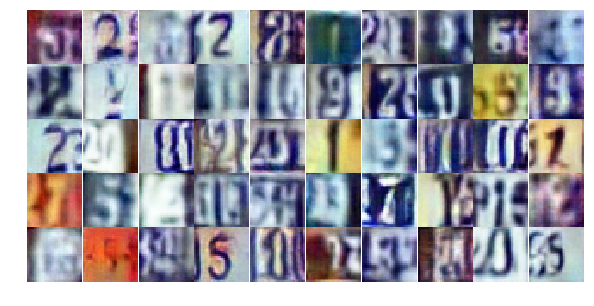

Epoch 17/20... Discriminator Loss: 0.7781... Generator Loss: 2.2159
Epoch 17/20... Discriminator Loss: 0.8875... Generator Loss: 2.2401
Epoch 17/20... Discriminator Loss: 0.7600... Generator Loss: 1.0816
Epoch 17/20... Discriminator Loss: 1.0232... Generator Loss: 0.6239
Epoch 18/20... Discriminator Loss: 0.8413... Generator Loss: 0.9124
Epoch 18/20... Discriminator Loss: 1.3411... Generator Loss: 0.4208
Epoch 18/20... Discriminator Loss: 0.7998... Generator Loss: 0.8827
Epoch 18/20... Discriminator Loss: 0.7298... Generator Loss: 0.9021
Epoch 18/20... Discriminator Loss: 1.0045... Generator Loss: 0.6831
Epoch 18/20... Discriminator Loss: 0.8450... Generator Loss: 0.8532


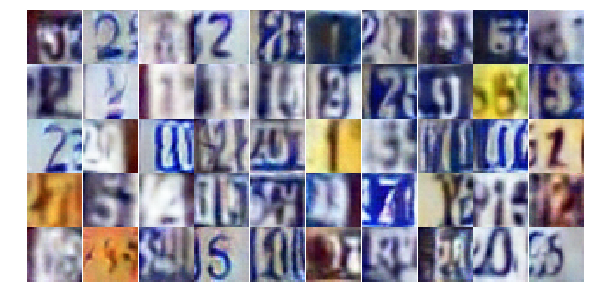

Epoch 18/20... Discriminator Loss: 0.4577... Generator Loss: 2.0523
Epoch 18/20... Discriminator Loss: 1.3550... Generator Loss: 0.4389
Epoch 18/20... Discriminator Loss: 0.7848... Generator Loss: 0.8019
Epoch 18/20... Discriminator Loss: 0.4056... Generator Loss: 2.0229
Epoch 18/20... Discriminator Loss: 0.6642... Generator Loss: 1.1226
Epoch 18/20... Discriminator Loss: 1.5443... Generator Loss: 0.3835
Epoch 18/20... Discriminator Loss: 0.6328... Generator Loss: 1.1294
Epoch 18/20... Discriminator Loss: 1.1676... Generator Loss: 0.5870
Epoch 18/20... Discriminator Loss: 0.6830... Generator Loss: 1.0192
Epoch 18/20... Discriminator Loss: 0.3638... Generator Loss: 1.5673


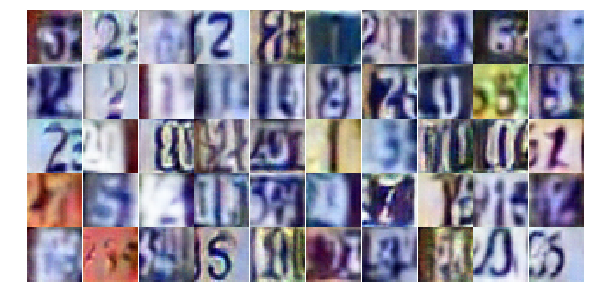

Epoch 18/20... Discriminator Loss: 0.3662... Generator Loss: 1.8187
Epoch 18/20... Discriminator Loss: 0.8618... Generator Loss: 0.8346
Epoch 18/20... Discriminator Loss: 1.0590... Generator Loss: 0.6098
Epoch 18/20... Discriminator Loss: 0.5162... Generator Loss: 1.3188
Epoch 18/20... Discriminator Loss: 0.6948... Generator Loss: 0.9712
Epoch 18/20... Discriminator Loss: 0.7303... Generator Loss: 1.1422
Epoch 18/20... Discriminator Loss: 0.6422... Generator Loss: 1.2799
Epoch 18/20... Discriminator Loss: 1.1385... Generator Loss: 0.6502
Epoch 18/20... Discriminator Loss: 0.6411... Generator Loss: 1.0360
Epoch 18/20... Discriminator Loss: 0.6577... Generator Loss: 0.9884


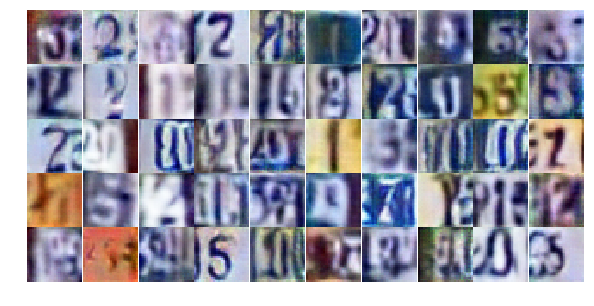

Epoch 18/20... Discriminator Loss: 0.5054... Generator Loss: 1.3367
Epoch 18/20... Discriminator Loss: 0.7073... Generator Loss: 2.3986
Epoch 18/20... Discriminator Loss: 0.8461... Generator Loss: 0.7971
Epoch 18/20... Discriminator Loss: 0.8203... Generator Loss: 0.8327
Epoch 18/20... Discriminator Loss: 0.9251... Generator Loss: 0.7278
Epoch 18/20... Discriminator Loss: 0.5715... Generator Loss: 1.2695
Epoch 18/20... Discriminator Loss: 0.6089... Generator Loss: 1.2249
Epoch 18/20... Discriminator Loss: 0.6366... Generator Loss: 1.2524
Epoch 18/20... Discriminator Loss: 0.4016... Generator Loss: 2.4033
Epoch 18/20... Discriminator Loss: 0.9224... Generator Loss: 0.9118


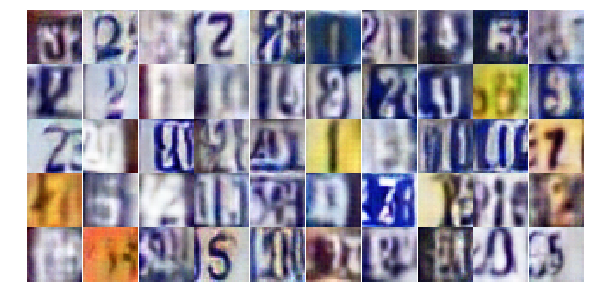

Epoch 18/20... Discriminator Loss: 0.6315... Generator Loss: 1.1029
Epoch 18/20... Discriminator Loss: 0.8793... Generator Loss: 0.7272
Epoch 18/20... Discriminator Loss: 0.7394... Generator Loss: 0.8901
Epoch 18/20... Discriminator Loss: 0.5276... Generator Loss: 1.3150
Epoch 18/20... Discriminator Loss: 0.8204... Generator Loss: 0.7794
Epoch 18/20... Discriminator Loss: 0.3759... Generator Loss: 1.5891
Epoch 18/20... Discriminator Loss: 1.1742... Generator Loss: 0.5542
Epoch 18/20... Discriminator Loss: 1.9538... Generator Loss: 3.6750
Epoch 18/20... Discriminator Loss: 0.7141... Generator Loss: 1.1905
Epoch 18/20... Discriminator Loss: 0.5194... Generator Loss: 1.2307


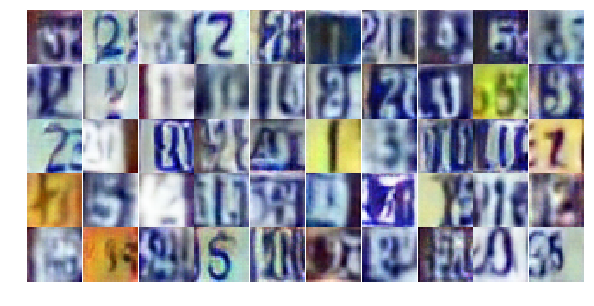

Epoch 18/20... Discriminator Loss: 0.8829... Generator Loss: 0.7234
Epoch 18/20... Discriminator Loss: 0.6767... Generator Loss: 1.1793
Epoch 18/20... Discriminator Loss: 0.5526... Generator Loss: 1.4974
Epoch 18/20... Discriminator Loss: 0.8444... Generator Loss: 0.8801
Epoch 18/20... Discriminator Loss: 0.8507... Generator Loss: 0.8337
Epoch 18/20... Discriminator Loss: 0.6805... Generator Loss: 1.1982
Epoch 18/20... Discriminator Loss: 0.4702... Generator Loss: 1.4021
Epoch 18/20... Discriminator Loss: 0.5469... Generator Loss: 1.2771
Epoch 18/20... Discriminator Loss: 1.0563... Generator Loss: 0.6077
Epoch 18/20... Discriminator Loss: 0.8516... Generator Loss: 0.7282


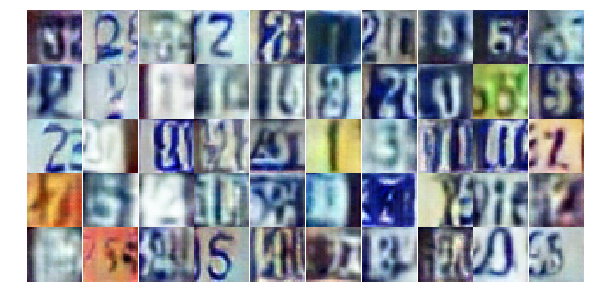

Epoch 18/20... Discriminator Loss: 0.7912... Generator Loss: 3.0171
Epoch 19/20... Discriminator Loss: 1.2546... Generator Loss: 0.5206
Epoch 19/20... Discriminator Loss: 1.3948... Generator Loss: 0.3975
Epoch 19/20... Discriminator Loss: 1.0853... Generator Loss: 0.5839
Epoch 19/20... Discriminator Loss: 0.6840... Generator Loss: 1.0357
Epoch 19/20... Discriminator Loss: 1.0428... Generator Loss: 0.7080
Epoch 19/20... Discriminator Loss: 0.4441... Generator Loss: 1.5401
Epoch 19/20... Discriminator Loss: 0.9934... Generator Loss: 0.6789
Epoch 19/20... Discriminator Loss: 0.6087... Generator Loss: 1.3001
Epoch 19/20... Discriminator Loss: 1.0830... Generator Loss: 0.6269


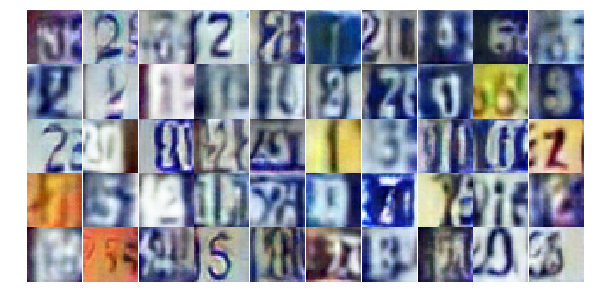

Epoch 19/20... Discriminator Loss: 0.4708... Generator Loss: 1.3100
Epoch 19/20... Discriminator Loss: 0.8709... Generator Loss: 0.7526
Epoch 19/20... Discriminator Loss: 0.6787... Generator Loss: 1.5068
Epoch 19/20... Discriminator Loss: 1.5248... Generator Loss: 0.3674
Epoch 19/20... Discriminator Loss: 0.5464... Generator Loss: 1.1708
Epoch 19/20... Discriminator Loss: 0.5353... Generator Loss: 1.5179
Epoch 19/20... Discriminator Loss: 0.8683... Generator Loss: 0.9379
Epoch 19/20... Discriminator Loss: 0.5241... Generator Loss: 1.3859
Epoch 19/20... Discriminator Loss: 0.7994... Generator Loss: 1.4156
Epoch 19/20... Discriminator Loss: 1.1831... Generator Loss: 0.5520


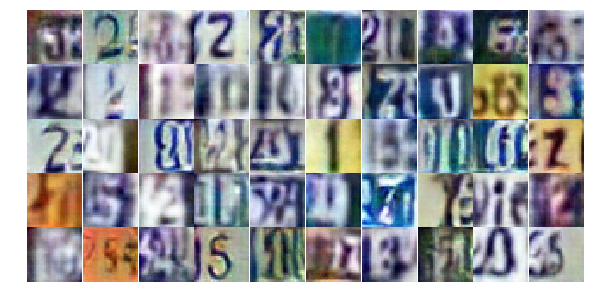

Epoch 19/20... Discriminator Loss: 0.7076... Generator Loss: 0.9928
Epoch 19/20... Discriminator Loss: 1.0233... Generator Loss: 0.7001
Epoch 19/20... Discriminator Loss: 1.2966... Generator Loss: 0.4673
Epoch 19/20... Discriminator Loss: 0.8941... Generator Loss: 0.8366
Epoch 19/20... Discriminator Loss: 1.5303... Generator Loss: 0.3599
Epoch 19/20... Discriminator Loss: 0.4492... Generator Loss: 2.1441
Epoch 19/20... Discriminator Loss: 0.6019... Generator Loss: 1.1476
Epoch 19/20... Discriminator Loss: 0.8674... Generator Loss: 2.6528
Epoch 19/20... Discriminator Loss: 0.6261... Generator Loss: 1.2834
Epoch 19/20... Discriminator Loss: 1.3247... Generator Loss: 0.6421


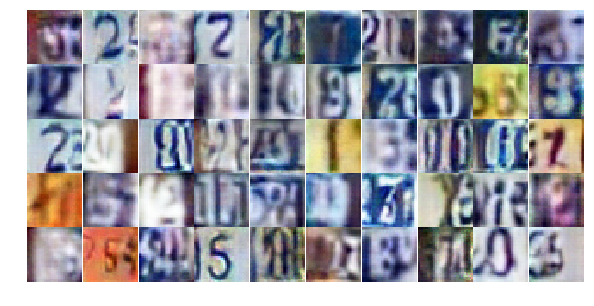

Epoch 19/20... Discriminator Loss: 0.8094... Generator Loss: 0.8155
Epoch 19/20... Discriminator Loss: 0.7000... Generator Loss: 0.9003
Epoch 19/20... Discriminator Loss: 1.0129... Generator Loss: 0.6339
Epoch 19/20... Discriminator Loss: 0.6056... Generator Loss: 1.1892
Epoch 19/20... Discriminator Loss: 0.4791... Generator Loss: 1.4650
Epoch 19/20... Discriminator Loss: 1.4906... Generator Loss: 0.3658
Epoch 19/20... Discriminator Loss: 0.4991... Generator Loss: 2.1242
Epoch 19/20... Discriminator Loss: 0.5084... Generator Loss: 1.4395
Epoch 19/20... Discriminator Loss: 0.9502... Generator Loss: 0.6832
Epoch 19/20... Discriminator Loss: 0.5074... Generator Loss: 1.2334


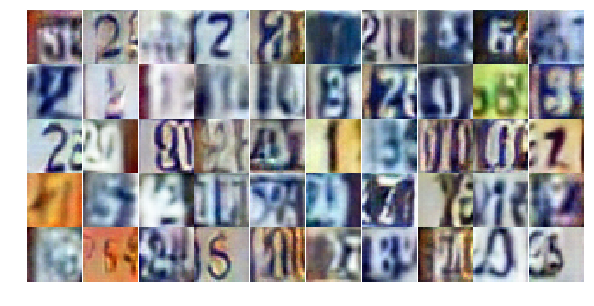

Epoch 19/20... Discriminator Loss: 0.5579... Generator Loss: 1.1279
Epoch 19/20... Discriminator Loss: 0.7015... Generator Loss: 1.0311
Epoch 19/20... Discriminator Loss: 0.8970... Generator Loss: 0.6961
Epoch 19/20... Discriminator Loss: 0.7362... Generator Loss: 0.9603
Epoch 19/20... Discriminator Loss: 0.8302... Generator Loss: 1.8012
Epoch 19/20... Discriminator Loss: 4.5329... Generator Loss: 5.5064
Epoch 19/20... Discriminator Loss: 1.9488... Generator Loss: 3.5188
Epoch 19/20... Discriminator Loss: 0.5151... Generator Loss: 1.8530
Epoch 19/20... Discriminator Loss: 0.6979... Generator Loss: 1.0495
Epoch 19/20... Discriminator Loss: 0.9208... Generator Loss: 0.7828


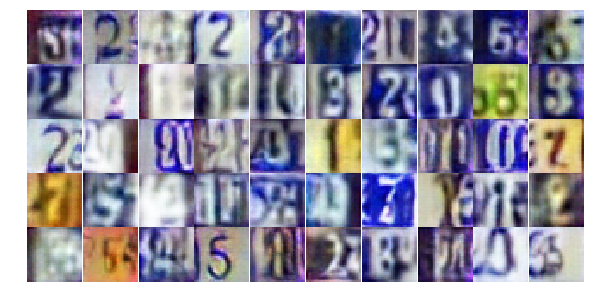

Epoch 19/20... Discriminator Loss: 0.6646... Generator Loss: 1.1087
Epoch 19/20... Discriminator Loss: 0.9190... Generator Loss: 0.8176
Epoch 19/20... Discriminator Loss: 0.6134... Generator Loss: 1.6792
Epoch 19/20... Discriminator Loss: 0.7055... Generator Loss: 1.2317
Epoch 19/20... Discriminator Loss: 0.8455... Generator Loss: 0.8357
Epoch 19/20... Discriminator Loss: 0.6779... Generator Loss: 1.5689
Epoch 19/20... Discriminator Loss: 1.5556... Generator Loss: 0.3682
Epoch 19/20... Discriminator Loss: 0.4714... Generator Loss: 1.5619
Epoch 20/20... Discriminator Loss: 0.6759... Generator Loss: 1.0610
Epoch 20/20... Discriminator Loss: 0.6864... Generator Loss: 1.0664


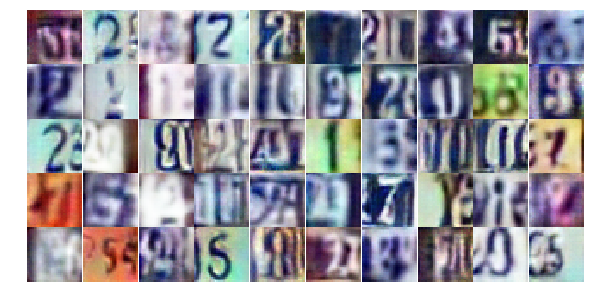

Epoch 20/20... Discriminator Loss: 0.7081... Generator Loss: 0.9154
Epoch 20/20... Discriminator Loss: 0.8866... Generator Loss: 0.7521
Epoch 20/20... Discriminator Loss: 0.8404... Generator Loss: 0.7804
Epoch 20/20... Discriminator Loss: 1.5447... Generator Loss: 0.3976
Epoch 20/20... Discriminator Loss: 1.0247... Generator Loss: 0.6290
Epoch 20/20... Discriminator Loss: 0.6093... Generator Loss: 1.2608
Epoch 20/20... Discriminator Loss: 0.8260... Generator Loss: 1.2762
Epoch 20/20... Discriminator Loss: 0.7489... Generator Loss: 1.0029
Epoch 20/20... Discriminator Loss: 0.9172... Generator Loss: 0.7426
Epoch 20/20... Discriminator Loss: 0.6323... Generator Loss: 1.0996


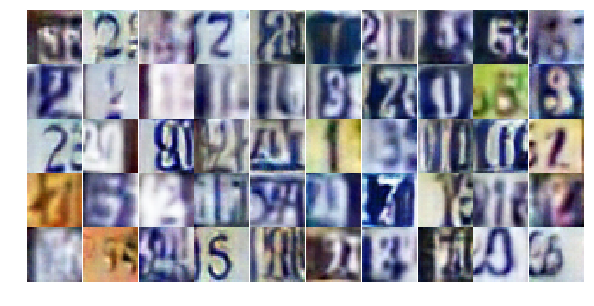

Epoch 20/20... Discriminator Loss: 1.0038... Generator Loss: 0.7356
Epoch 20/20... Discriminator Loss: 0.7368... Generator Loss: 1.3731
Epoch 20/20... Discriminator Loss: 0.6344... Generator Loss: 1.3202
Epoch 20/20... Discriminator Loss: 0.5719... Generator Loss: 1.5867
Epoch 20/20... Discriminator Loss: 0.7863... Generator Loss: 0.8803
Epoch 20/20... Discriminator Loss: 0.8305... Generator Loss: 0.7777
Epoch 20/20... Discriminator Loss: 0.8308... Generator Loss: 0.8500
Epoch 20/20... Discriminator Loss: 0.7579... Generator Loss: 0.8530
Epoch 20/20... Discriminator Loss: 0.6930... Generator Loss: 1.0407
Epoch 20/20... Discriminator Loss: 1.4851... Generator Loss: 0.3949


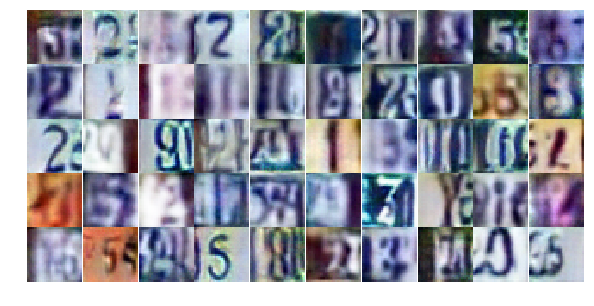

Epoch 20/20... Discriminator Loss: 0.6481... Generator Loss: 1.0659
Epoch 20/20... Discriminator Loss: 0.6482... Generator Loss: 1.1037
Epoch 20/20... Discriminator Loss: 0.2977... Generator Loss: 1.9765
Epoch 20/20... Discriminator Loss: 1.2699... Generator Loss: 0.4444
Epoch 20/20... Discriminator Loss: 1.1190... Generator Loss: 0.6690
Epoch 20/20... Discriminator Loss: 0.6201... Generator Loss: 1.0561
Epoch 20/20... Discriminator Loss: 0.5069... Generator Loss: 1.2867
Epoch 20/20... Discriminator Loss: 1.7442... Generator Loss: 0.2947
Epoch 20/20... Discriminator Loss: 1.0513... Generator Loss: 0.6483
Epoch 20/20... Discriminator Loss: 0.4249... Generator Loss: 1.4019


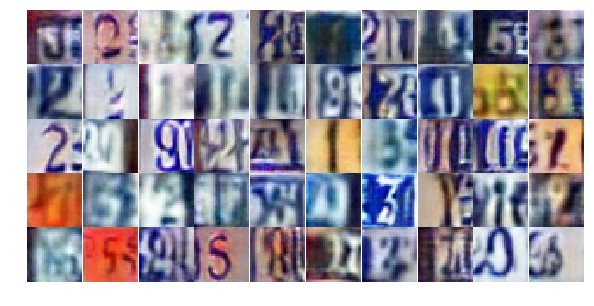

Epoch 20/20... Discriminator Loss: 1.0389... Generator Loss: 0.6003
Epoch 20/20... Discriminator Loss: 0.6374... Generator Loss: 1.0075
Epoch 20/20... Discriminator Loss: 0.9055... Generator Loss: 0.8456
Epoch 20/20... Discriminator Loss: 0.9009... Generator Loss: 3.3496
Epoch 20/20... Discriminator Loss: 1.2670... Generator Loss: 0.5195
Epoch 20/20... Discriminator Loss: 0.5991... Generator Loss: 1.3169
Epoch 20/20... Discriminator Loss: 0.8390... Generator Loss: 1.1995
Epoch 20/20... Discriminator Loss: 1.0263... Generator Loss: 0.6685
Epoch 20/20... Discriminator Loss: 0.9009... Generator Loss: 0.8831
Epoch 20/20... Discriminator Loss: 0.8406... Generator Loss: 0.8979


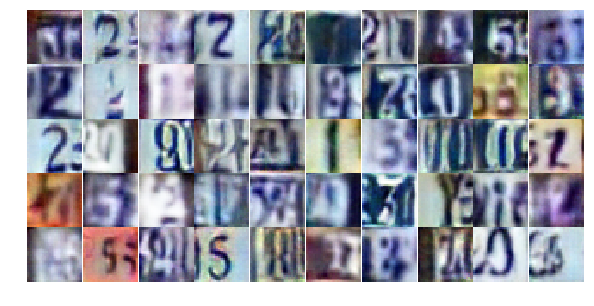

Epoch 20/20... Discriminator Loss: 0.9624... Generator Loss: 0.7635
Epoch 20/20... Discriminator Loss: 0.8054... Generator Loss: 0.8001
Epoch 20/20... Discriminator Loss: 0.3788... Generator Loss: 2.2433
Epoch 20/20... Discriminator Loss: 3.2472... Generator Loss: 0.0845
Epoch 20/20... Discriminator Loss: 1.9984... Generator Loss: 2.0077
Epoch 20/20... Discriminator Loss: 1.1493... Generator Loss: 0.8691
Epoch 20/20... Discriminator Loss: 1.0357... Generator Loss: 0.9097
Epoch 20/20... Discriminator Loss: 0.4641... Generator Loss: 1.9472
Epoch 20/20... Discriminator Loss: 0.8372... Generator Loss: 1.4336
Epoch 20/20... Discriminator Loss: 1.0813... Generator Loss: 0.6310


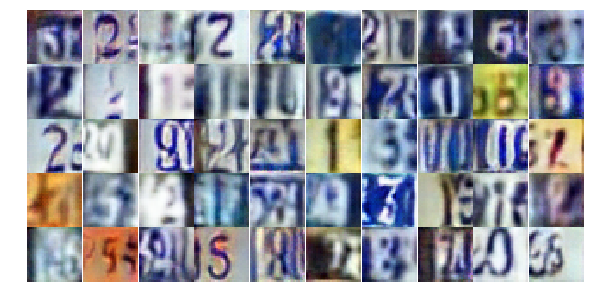

Epoch 20/20... Discriminator Loss: 0.5909... Generator Loss: 1.2914
Epoch 20/20... Discriminator Loss: 0.8843... Generator Loss: 0.8058
Epoch 20/20... Discriminator Loss: 0.3972... Generator Loss: 1.7522
Epoch 20/20... Discriminator Loss: 0.6452... Generator Loss: 1.3205
Epoch 20/20... Discriminator Loss: 0.5533... Generator Loss: 1.1906
Epoch 20/20... Discriminator Loss: 0.7171... Generator Loss: 0.9517


In [20]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

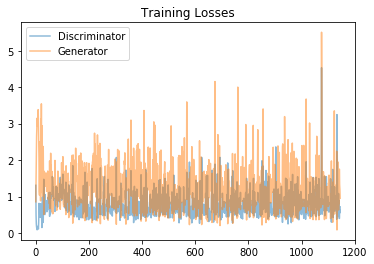

In [21]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

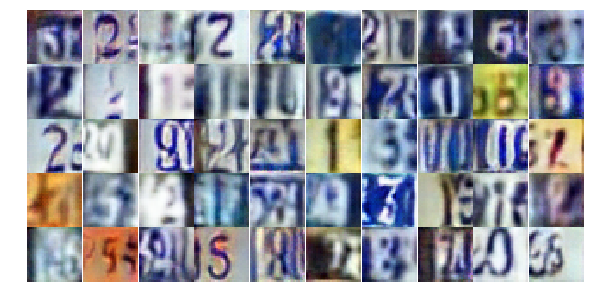

In [22]:
_ = view_samples(-1, samples, 5, 10, figsize=(10,5))